In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

In [2]:
# %cd /content/drive/MyDrive/創生課題/8/
%ls

Kadai0803.ipynb  NuralNetwork.ipynb  data/  facades_dataset.mat


In [3]:
import torch
import torch.nn as nn
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt

from torchvision import datasets, transforms
import os
import glob
import numpy as np
import scipy.io

In [4]:
# 学習用パラメーター

im_size = (64,64) #画像サイズ
epoch = 100 #学習回数
mini_batch = 40 #ミニバッチサイズ
adam_lr_GF = .001 # Adamの学習係数（G用）
adam_lr_D = .001 # Adamの学習係数（D用）
lambda_L1 = 100.0 # L1用正規化係数
dev = torch.device('cuda:0' if torch.cuda.is_available() else "cpu")

data_name = "facades_dataset.mat"

dictionary = scipy.io.loadmat(data_name)

x_train = torch.tensor(dictionary["x_train"]).to(dev)/128.0 -1
x_train = torch.permute(x_train,(0,3,1,2))#次元入れ替え？後で調べる
y_train = torch.tensor(dictionary["y_train"]).to(dev)/128.0 -1
y_train = torch.permute(y_train,(0,3,1,2))
# 正規化
x_test = torch.tensor(dictionary["x_test"]).to(dev)/128.0 -1
x_test = torch.permute(x_test,(0,3,1,2))
y_test = torch.tensor(dictionary["y_test"]).to(dev)/128.0 -1
y_test = torch.permute(y_test,(0,3,1,2))

In [5]:
class PatchDiscriminator(nn.Module):
  def __init__(self,input_shape=(64,64)):
    super(PatchDiscriminator, self).__init__()
    downsample = nn.MaxPool2d(2,2)
    self.layers = nn.Sequential(
        nn.Conv2d(3,64,3,padding=1,padding_mode = "reflect"),
        nn.LeakyReLU(.2,True),downsample,
        nn.Conv2d(64,128,3,padding=1,padding_mode='reflect'),
        nn.LeakyReLU(.2,True),downsample,
        nn.Conv2d(128,256,3,padding=1,padding_mode='reflect'),
        nn.LeakyReLU(.2,True),downsample,
        nn.Conv2d(256,1,3,padding=1,padding_mode='reflect'),
        nn.Sigmoid()
    )
  def forward(self,input):
    return self.layers(input)


In [6]:
def conv_block(in_ch,out_ch):
  return nn.Sequential(
      nn.Conv2d(in_ch,out_ch,3,padding=1,padding_mode='reflect'),
      nn.BatchNorm2d(out_ch),
      nn.LeakyReLU(.2,True),
      nn.Conv2d(out_ch,out_ch,3,padding=1,padding_mode='reflect'),
      nn.LeakyReLU(.2,True)
  )

In [7]:

class UNet(nn.Module):
  def __init__(self):
    super(UNet,self).__init__()

    self.downsample = nn.MaxPool2d(2,2)
    upsample = nn.Upsample(scale_factor=2,mode='bilinear')

    self.layers_0_f = conv_block(3,64)
    self.layers_0_b = conv_block(128,64)
    self.layers_last = nn.Sequential(nn.Conv2d(64,3,1),nn.Tanh())

    self.layers_1_f = conv_block(64,128)
    self.layers_1_b = conv_block(256,128)
    self.layers_1up = nn.Sequential(
        upsample,
        nn.Conv2d(128,64,3,padding=1,padding_mode='reflect'),
        nn.BatchNorm2d(64),nn.LeakyReLU(.2,True),
    )
    self.layers_2_f = conv_block(128,256)
    self.layers_2_b = conv_block(512,256)
    self.layers_2up = nn.Sequential(
        upsample,
        nn.Conv2d(256,128,3,padding=1,padding_mode='reflect'),
        nn.BatchNorm2d(128),nn.LeakyReLU(.2,True),
    )

    self.layers_3 = conv_block(256,512)
    self.layers_3up = nn.Sequential(
        upsample,
        nn.Conv2d(512,256,3,padding=1,padding_mode='reflect'),
        nn.BatchNorm2d(256),nn.LeakyReLU(.2,True)
    )
  def forward(self,input):
    h0 = self.layers_0_f(input)
    h1 = self.layers_1_f(self.downsample(h0))
    h2 = self.layers_2_f(self.downsample(h1))
    h3 = self.layers_3(self.downsample(h2))
    h3 = self.layers_3up(h3)
    h2 = self.layers_2_b(torch.cat((h2,h3),dim=1))
    h2 = self.layers_2up(h2)
    h1 = self.layers_1_b(torch.cat((h1,h2),dim=1))
    h1 = self.layers_1up(h1)
    h0 = self.layers_0_b(torch.cat((h0,h1),dim=1))
    return self.layers_last(h0)


In [8]:
def get_images(x,clmn):
  img_rows = []
  for i in range(int(x.shape[0]/clmn)):
    img_columns = []
    for j in range(clmn):
      img_columns.append(x[i*clmn+j,:,:])
    img_rows.append(torch.cat(img_columns,dim=1))
  images = torch.cat(img_rows,dim=0)
  return images.to('cpu').detach().numpy().copy()

def get_z(N,dim_z):
  return 2*(torch.rand(size=(N,dim_z))-.5)

# torch.manual_seed(5) # 乱数を固定（うまくいかなかったら）

# Main

# 各モデルの用意
G = UNet().to(dev)
F = UNet().to(dev)
DY = PatchDiscriminator(im_size).to(dev)
DX = PatchDiscriminator(im_size).to(dev)

# 最適化手法
opt_GF = torch.optim.Adam(\
                         list(G.parameters())+list(F.parameters()),lr=adam_lr_GF,betas=(.5,.999))
opt_D = torch.optim.Adam(\
                         list(DX.parameters())+list(DY.parameters()),lr=adam_lr_GF,betas=(0.5,0.999))
# 規範ベース
bceloss = nn.BCELoss(reduction='sum')
l1loss = nn.L1Loss(reduction='sum')
# 学習データの分割
x_trains = torch.split(x_train,mini_batch)
random_choice = torch.randperm(y_train.shape[0])
y_trains = torch.split(y_train,mini_batch)


In epoch =    1/100. mean of V(D,G) = -110.45978546142578/40



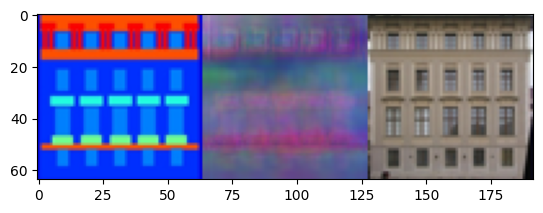

In epoch =    1/100. mean of V(D,G) = -88.46600532531738/80



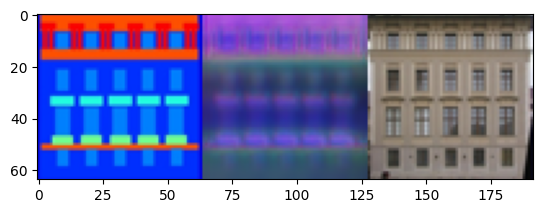

In epoch =    1/100. mean of V(D,G) = -65.81401348114014/120



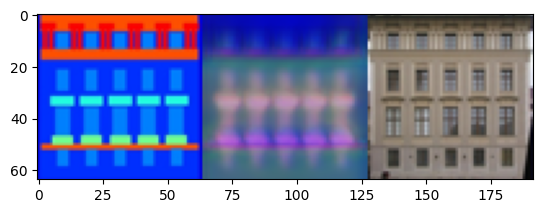

In epoch =    1/100. mean of V(D,G) = -48.57902526855469/160



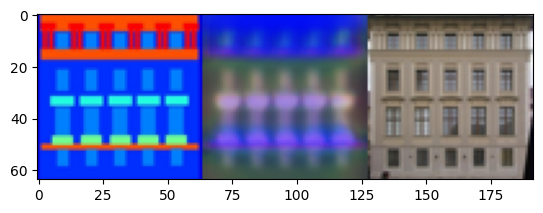

In epoch =    1/100. mean of V(D,G) = -34.01062250137329/200



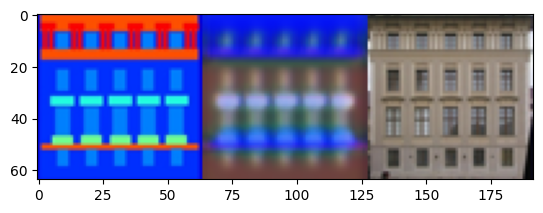

In epoch =    1/100. mean of V(D,G) = -14.798059463500977/240



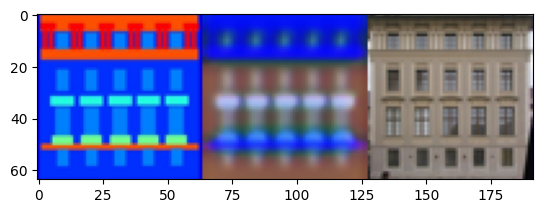

In epoch =    1/100. mean of V(D,G) = -10.978132486343384/280



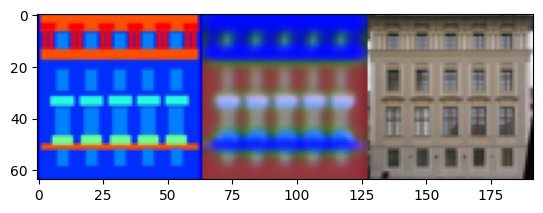

In epoch =    1/100. mean of V(D,G) = -2.4152013659477234/320



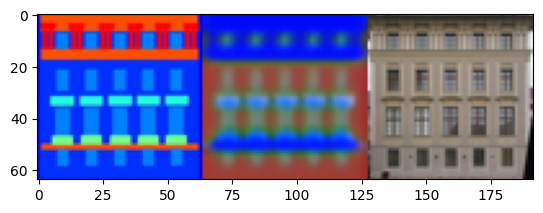

In epoch =    1/100. mean of V(D,G) = -1.9733700156211853/360



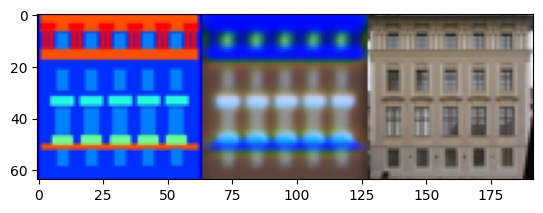

In epoch =    1/100. mean of V(D,G) = -0.9591047465801239/400



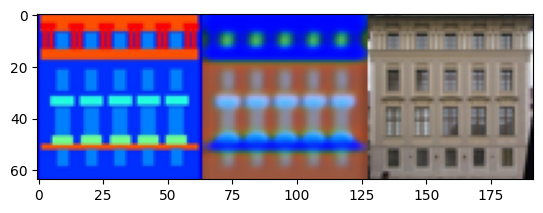

In epoch =    2/100. mean of V(D,G) = -0.4880005121231079/40



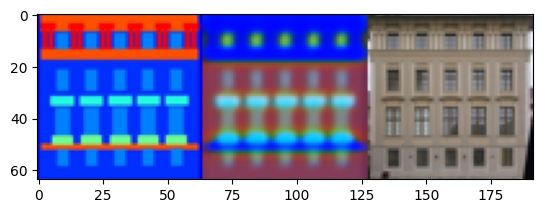

In epoch =    2/100. mean of V(D,G) = -0.4682626575231552/80



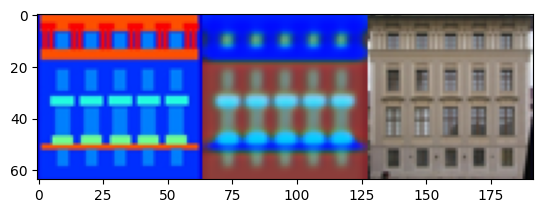

In epoch =    2/100. mean of V(D,G) = -0.34396253526210785/120



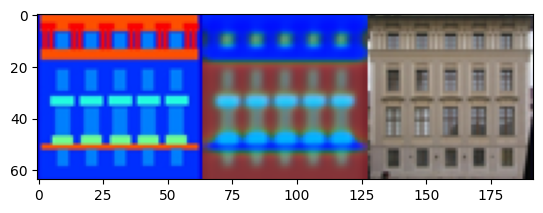

In epoch =    2/100. mean of V(D,G) = -1.0611258447170258/160



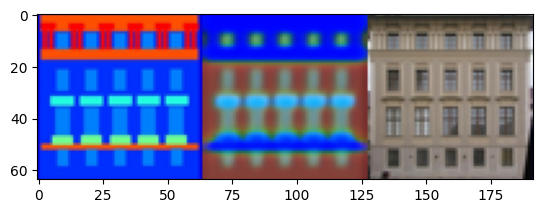

In epoch =    2/100. mean of V(D,G) = -0.5540389567613602/200



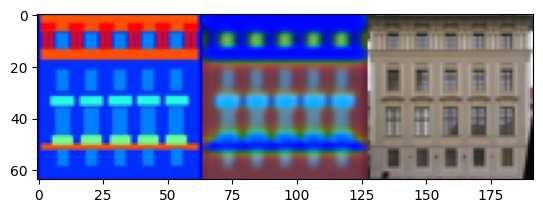

In epoch =    2/100. mean of V(D,G) = -0.25374623015522957/240



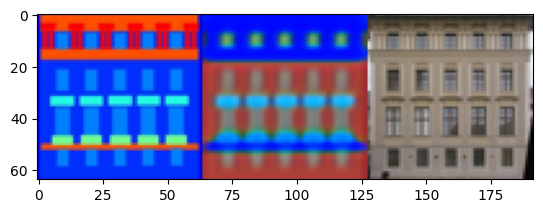

In epoch =    2/100. mean of V(D,G) = -0.7889784872531891/280



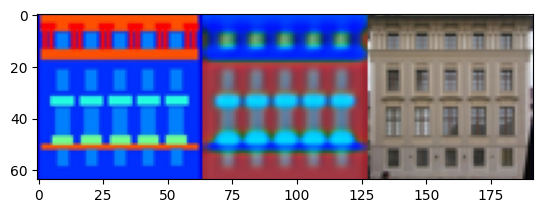

In epoch =    2/100. mean of V(D,G) = -0.16001716256141663/320



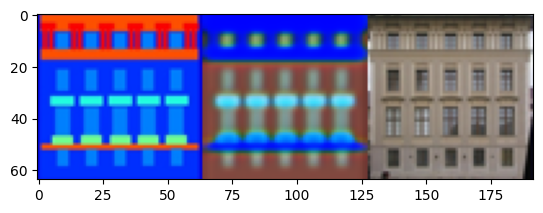

In epoch =    2/100. mean of V(D,G) = -0.14809567481279373/360



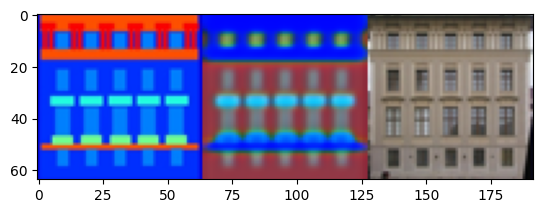

In epoch =    2/100. mean of V(D,G) = -0.15060295350849628/400



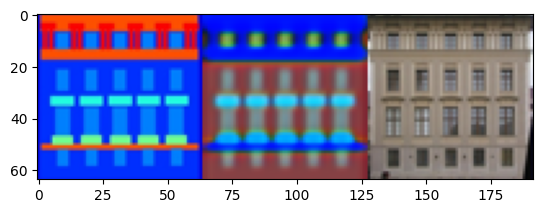

In epoch =    3/100. mean of V(D,G) = -0.11355740949511528/40



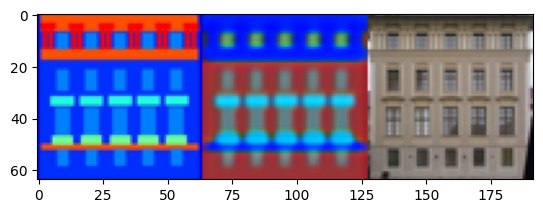

In epoch =    3/100. mean of V(D,G) = -0.1300307083874941/80



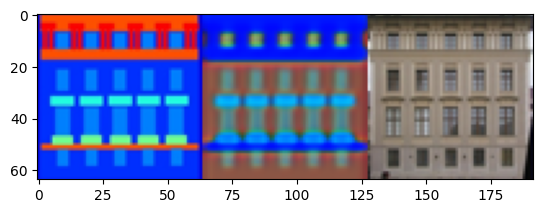

In epoch =    3/100. mean of V(D,G) = -0.07302284240722656/120



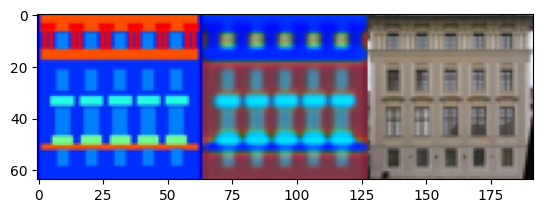

In epoch =    3/100. mean of V(D,G) = -1.1169638484716415/160



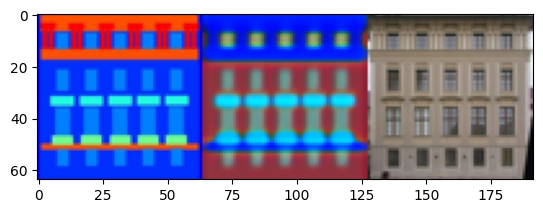

In epoch =    3/100. mean of V(D,G) = -0.22684995085000992/200



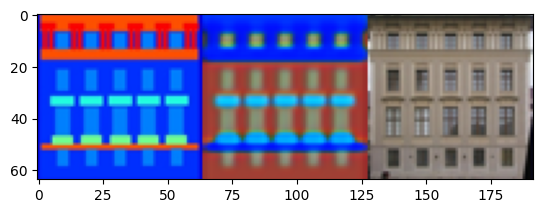

In epoch =    3/100. mean of V(D,G) = -1.4615413546562195/240



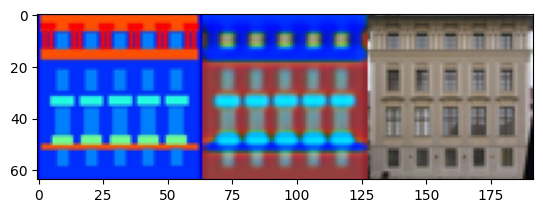

In epoch =    3/100. mean of V(D,G) = -235.17946243286133/280



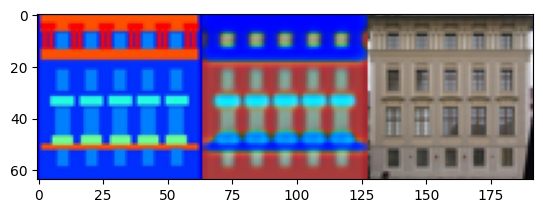

In epoch =    3/100. mean of V(D,G) = -785.3694152832031/320



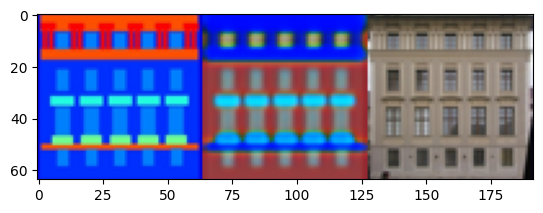

In epoch =    3/100. mean of V(D,G) = -58.56509208679199/360



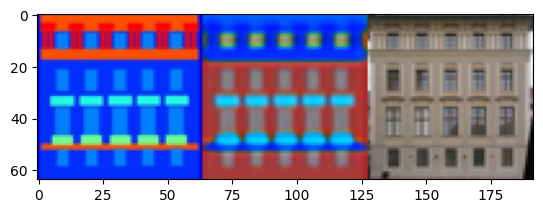

In epoch =    3/100. mean of V(D,G) = -7.302405834197998/400



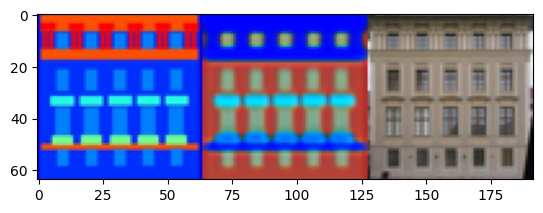

In epoch =    4/100. mean of V(D,G) = -27.28991985321045/40



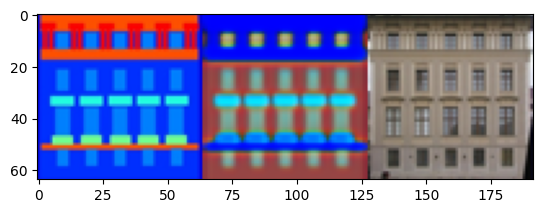

In epoch =    4/100. mean of V(D,G) = -35.7932710647583/80



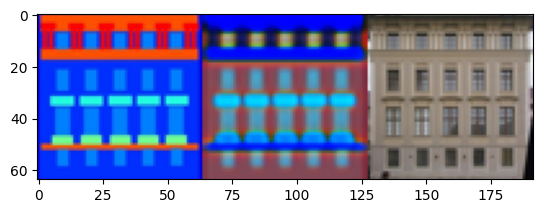

In epoch =    4/100. mean of V(D,G) = -15.372798442840576/120



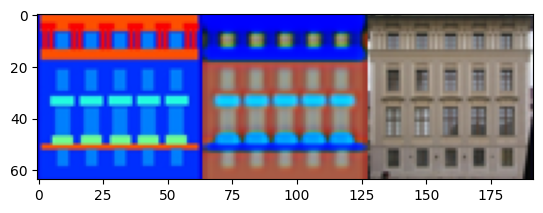

In epoch =    4/100. mean of V(D,G) = -15.078866481781006/160



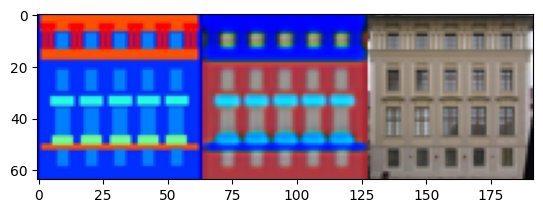

In epoch =    4/100. mean of V(D,G) = -12.312586307525635/200



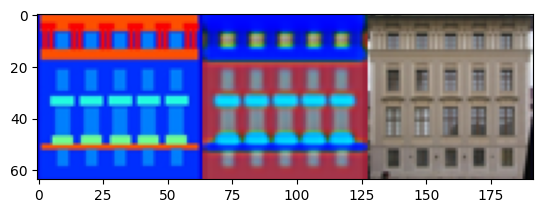

In epoch =    4/100. mean of V(D,G) = -8.44732940196991/240



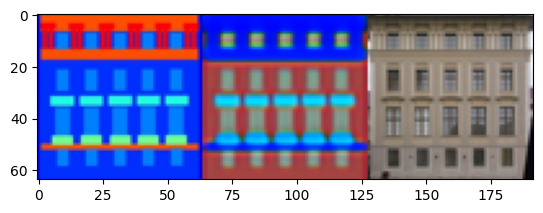

In epoch =    4/100. mean of V(D,G) = -7.420392632484436/280



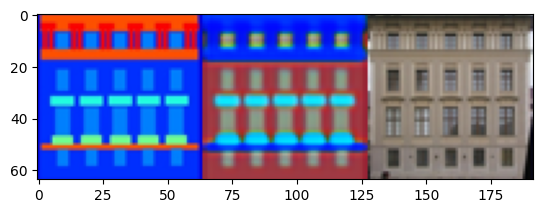

In epoch =    4/100. mean of V(D,G) = -6.83474600315094/320



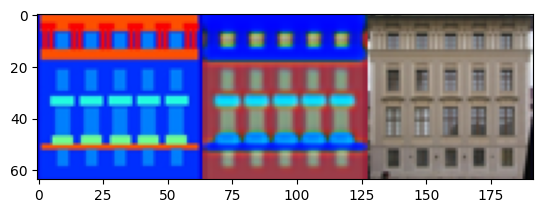

In epoch =    4/100. mean of V(D,G) = -7.2209131717681885/360



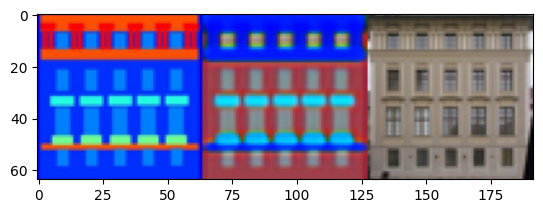

In epoch =    4/100. mean of V(D,G) = -8.028771877288818/400



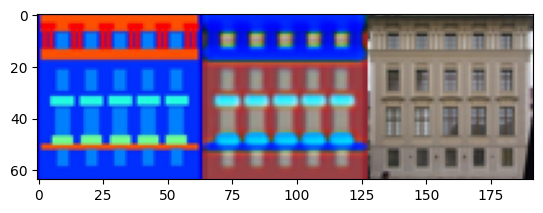

In epoch =    5/100. mean of V(D,G) = -6.503294110298157/40



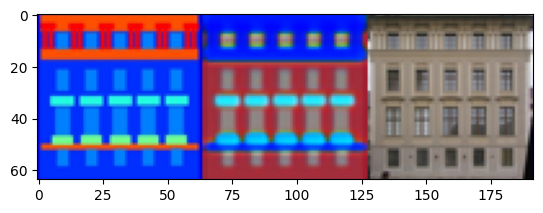

In epoch =    5/100. mean of V(D,G) = -6.922234296798706/80



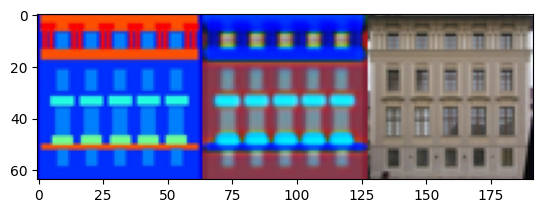

In epoch =    5/100. mean of V(D,G) = -5.171397924423218/120



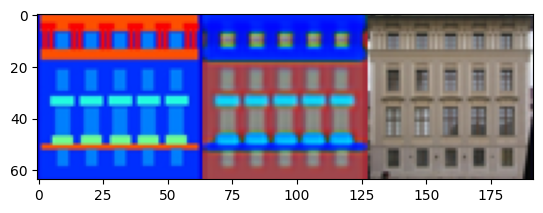

In epoch =    5/100. mean of V(D,G) = -6.200497150421143/160



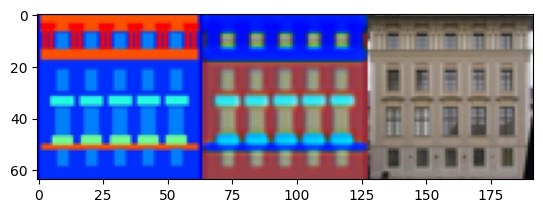

In epoch =    5/100. mean of V(D,G) = -6.465978622436523/200



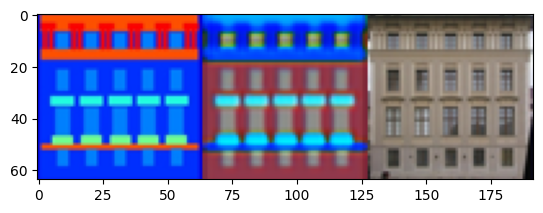

In epoch =    5/100. mean of V(D,G) = -7.335612773895264/240



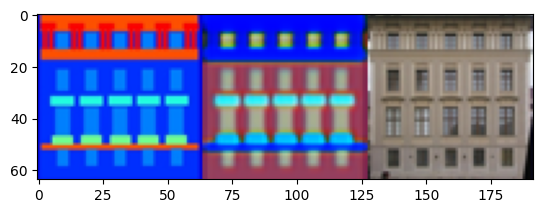

In epoch =    5/100. mean of V(D,G) = -9.854063987731934/280



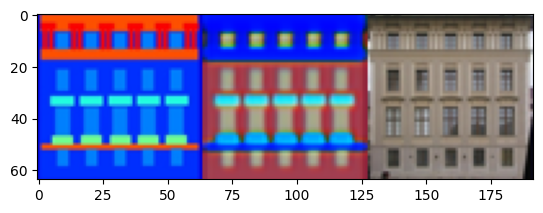

In epoch =    5/100. mean of V(D,G) = -23.341033458709717/320



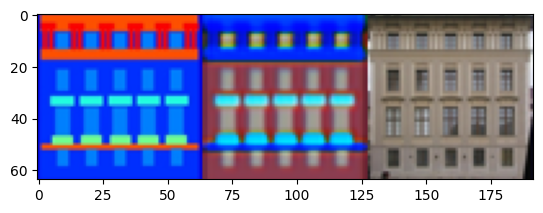

In epoch =    5/100. mean of V(D,G) = -108.69902610778809/360



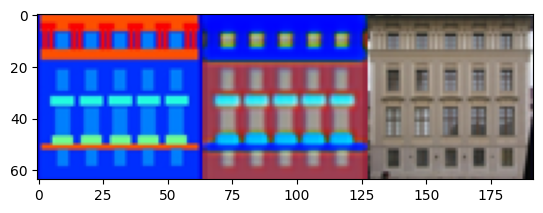

In epoch =    5/100. mean of V(D,G) = -17.242262363433838/400



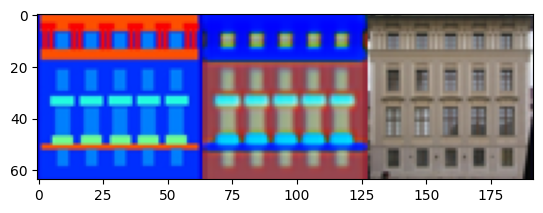

In epoch =    6/100. mean of V(D,G) = -19.91063952445984/40



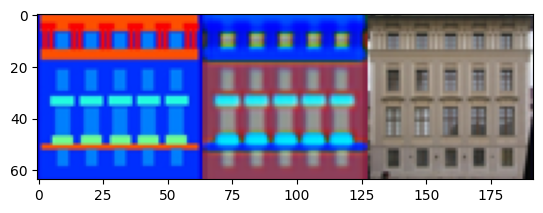

In epoch =    6/100. mean of V(D,G) = -38.20012092590332/80



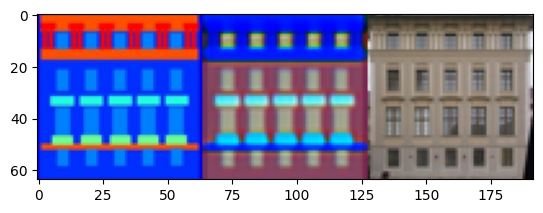

In epoch =    6/100. mean of V(D,G) = -10.6972336769104/120



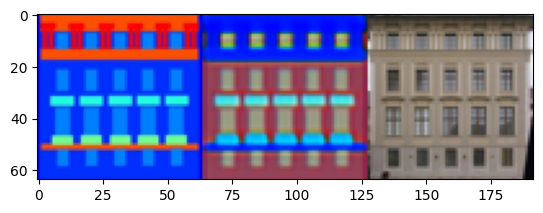

In epoch =    6/100. mean of V(D,G) = -21.67567491531372/160



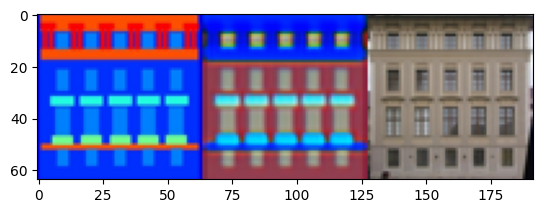

In epoch =    6/100. mean of V(D,G) = -17.512649297714233/200



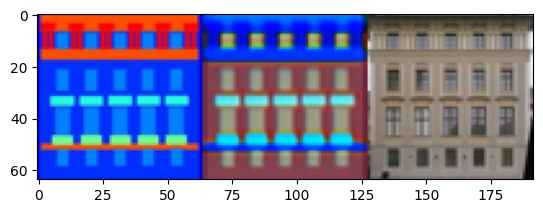

In epoch =    6/100. mean of V(D,G) = -19.066522121429443/240



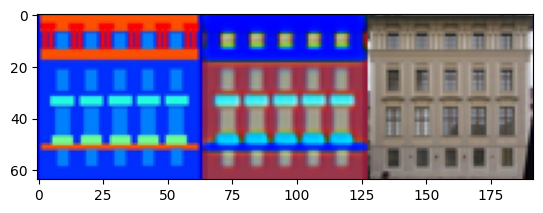

In epoch =    6/100. mean of V(D,G) = -10.359833240509033/280



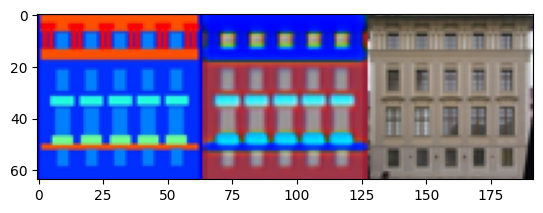

In epoch =    6/100. mean of V(D,G) = -14.138859510421753/320



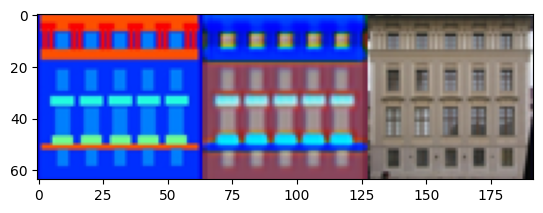

In epoch =    6/100. mean of V(D,G) = -16.331424713134766/360



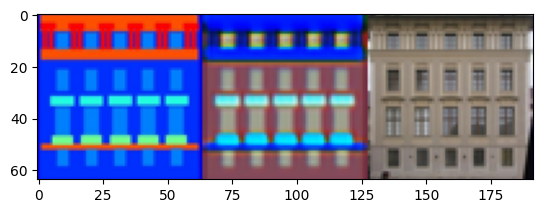

In epoch =    6/100. mean of V(D,G) = -6.9970703125/400



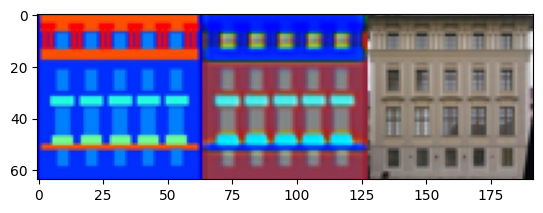

In epoch =    7/100. mean of V(D,G) = -11.431354284286499/40



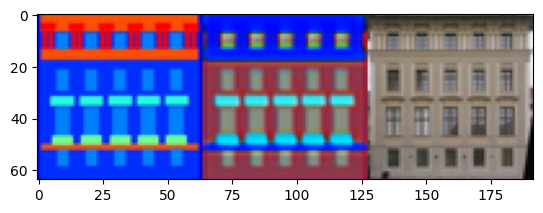

In epoch =    7/100. mean of V(D,G) = -13.755054473876953/80



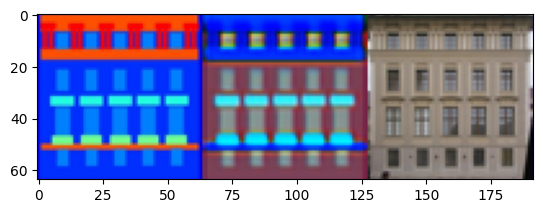

In epoch =    7/100. mean of V(D,G) = -10.123991966247559/120



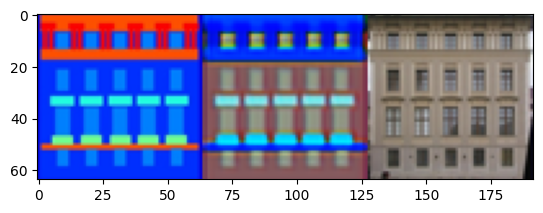

In epoch =    7/100. mean of V(D,G) = -13.661736249923706/160



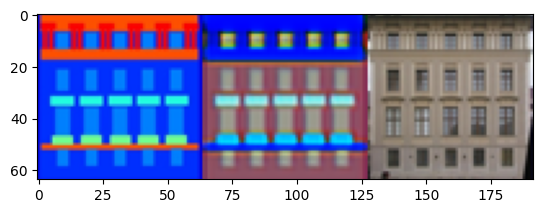

In epoch =    7/100. mean of V(D,G) = -21.410458087921143/200



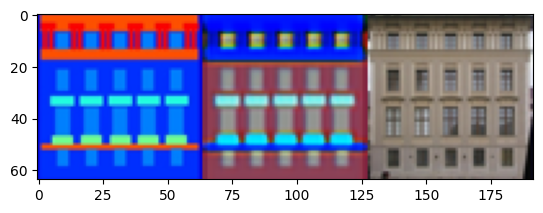

In epoch =    7/100. mean of V(D,G) = -74.60994720458984/240



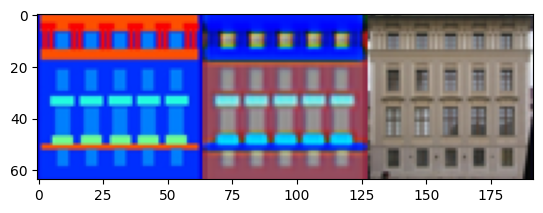

In epoch =    7/100. mean of V(D,G) = -26.13755464553833/280



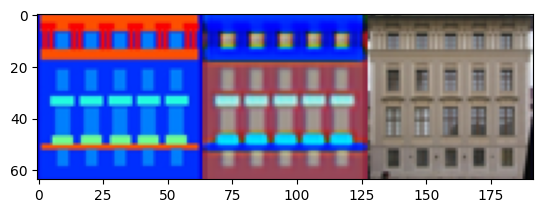

In epoch =    7/100. mean of V(D,G) = -11.543675661087036/320



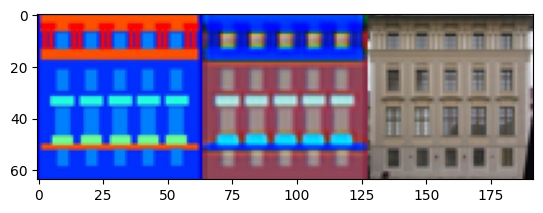

In epoch =    7/100. mean of V(D,G) = -39.29804801940918/360



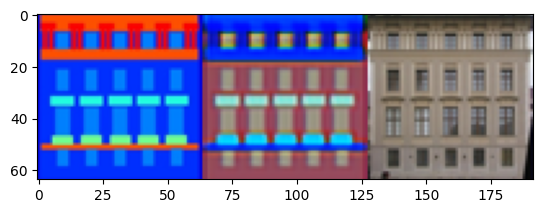

In epoch =    7/100. mean of V(D,G) = -11.852495670318604/400



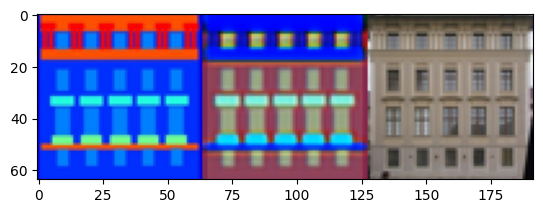

In epoch =    8/100. mean of V(D,G) = -17.12248921394348/40



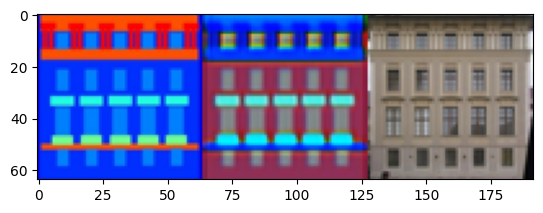

In epoch =    8/100. mean of V(D,G) = -17.295968532562256/80



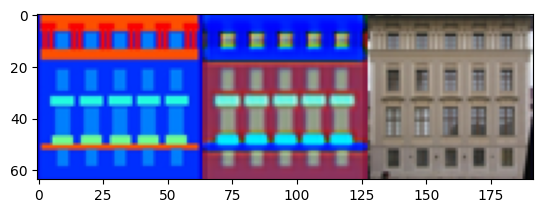

In epoch =    8/100. mean of V(D,G) = -13.896338939666748/120



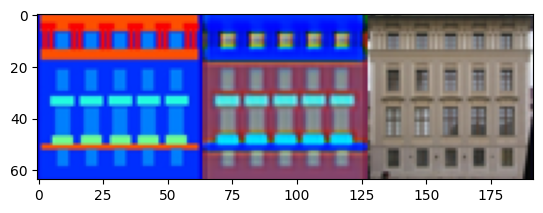

In epoch =    8/100. mean of V(D,G) = -18.639113903045654/160



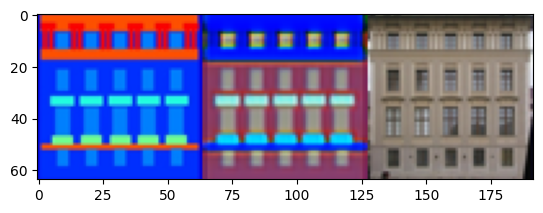

In epoch =    8/100. mean of V(D,G) = -9.119298458099365/200



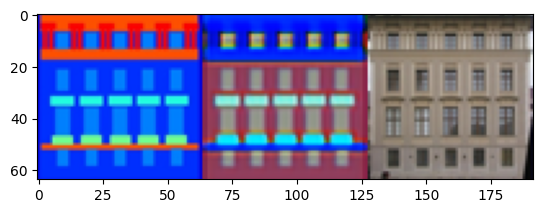

In epoch =    8/100. mean of V(D,G) = -8.404867053031921/240



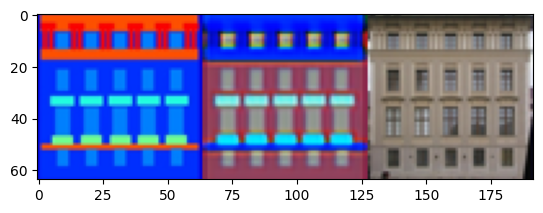

In epoch =    8/100. mean of V(D,G) = -14.404816627502441/280



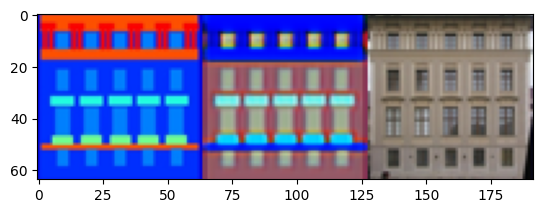

In epoch =    8/100. mean of V(D,G) = -9.342761635780334/320



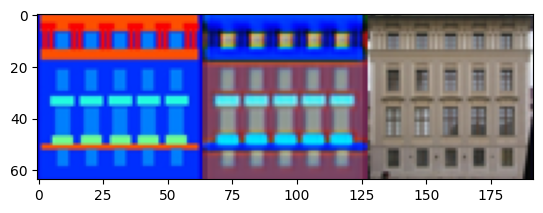

In epoch =    8/100. mean of V(D,G) = -13.323854207992554/360



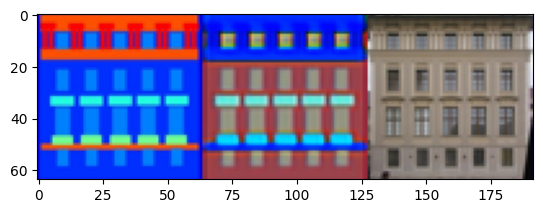

In epoch =    8/100. mean of V(D,G) = -7.211999297142029/400



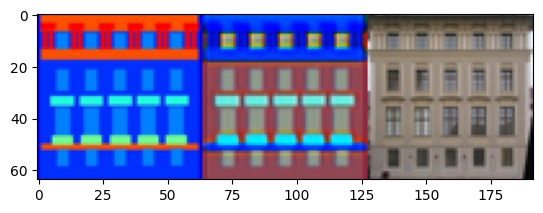

In epoch =    9/100. mean of V(D,G) = -8.006809949874878/40



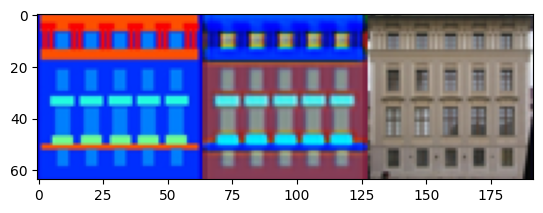

In epoch =    9/100. mean of V(D,G) = -11.995347738265991/80



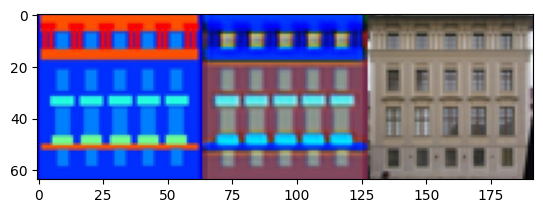

In epoch =    9/100. mean of V(D,G) = -8.197073340415955/120



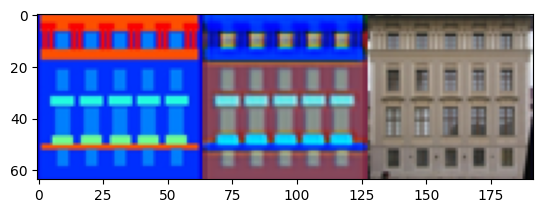

In epoch =    9/100. mean of V(D,G) = -13.02197813987732/160



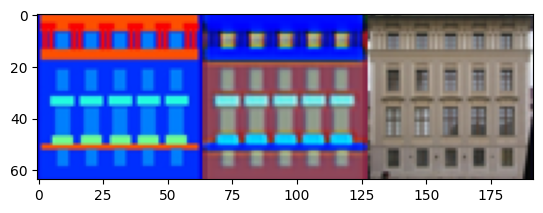

In epoch =    9/100. mean of V(D,G) = -13.292527198791504/200



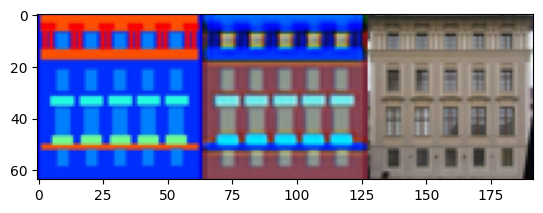

In epoch =    9/100. mean of V(D,G) = -11.035641431808472/240



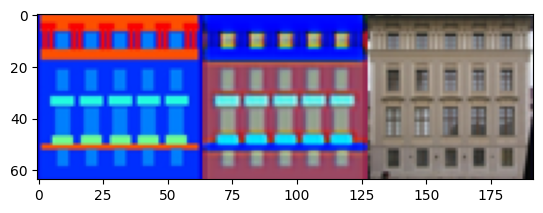

In epoch =    9/100. mean of V(D,G) = -10.314295291900635/280



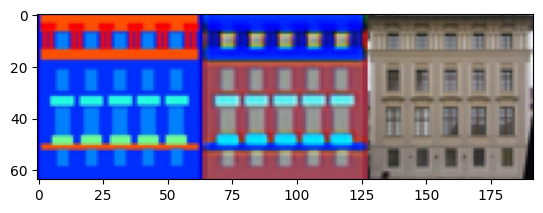

In epoch =    9/100. mean of V(D,G) = -8.907159566879272/320



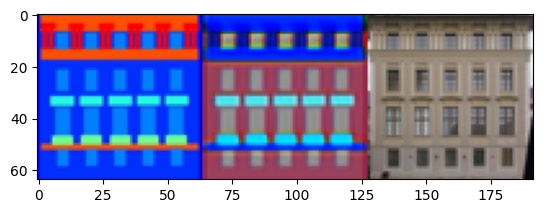

In epoch =    9/100. mean of V(D,G) = -11.474064588546753/360



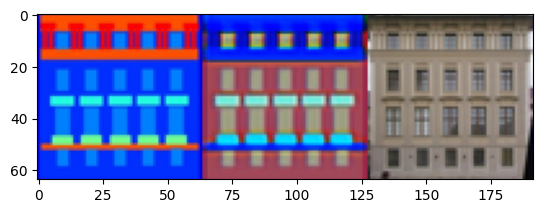

In epoch =    9/100. mean of V(D,G) = -8.356158137321472/400



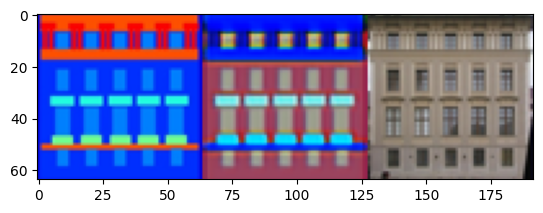

In epoch =   10/100. mean of V(D,G) = -10.765860080718994/40



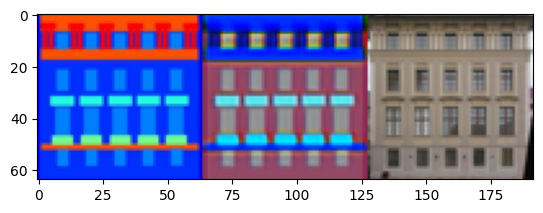

In epoch =   10/100. mean of V(D,G) = -12.77658224105835/80



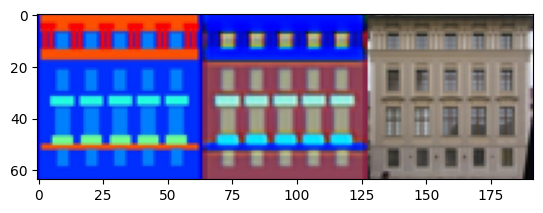

In epoch =   10/100. mean of V(D,G) = -6.848344802856445/120



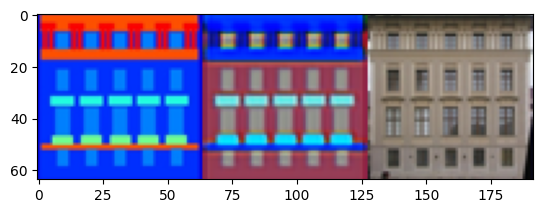

In epoch =   10/100. mean of V(D,G) = -12.20845341682434/160



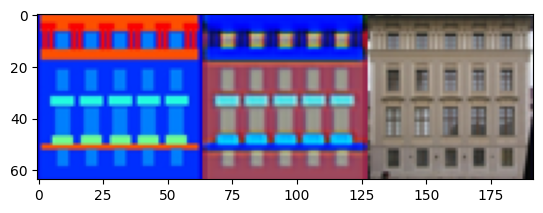

In epoch =   10/100. mean of V(D,G) = -8.593512177467346/200



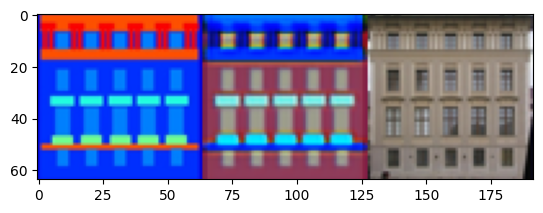

In epoch =   10/100. mean of V(D,G) = -10.308457612991333/240



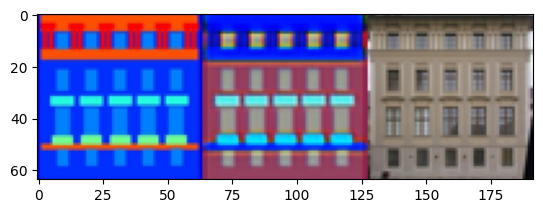

In epoch =   10/100. mean of V(D,G) = -6.088864803314209/280



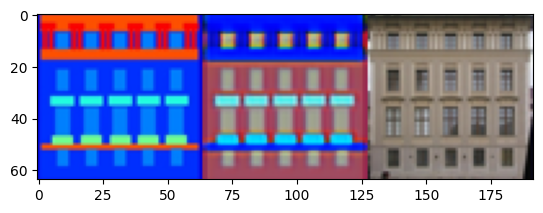

In epoch =   10/100. mean of V(D,G) = -6.717450022697449/320



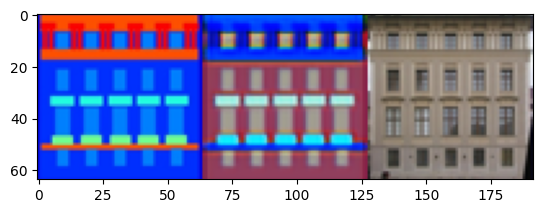

In epoch =   10/100. mean of V(D,G) = -10.944459438323975/360



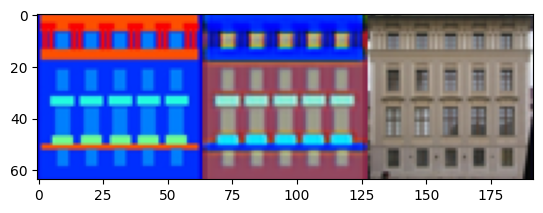

In epoch =   10/100. mean of V(D,G) = -4.5708417892456055/400



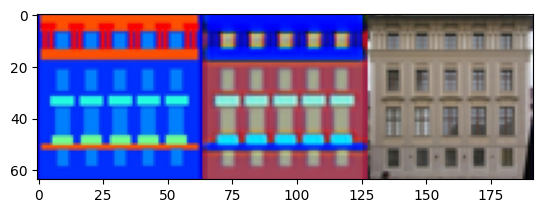

In epoch =   11/100. mean of V(D,G) = -5.953506827354431/40



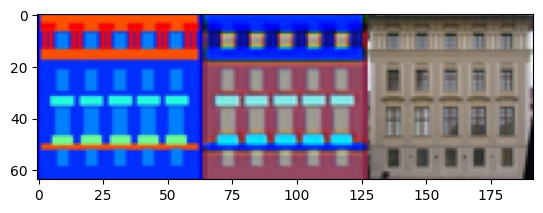

In epoch =   11/100. mean of V(D,G) = -9.688549041748047/80



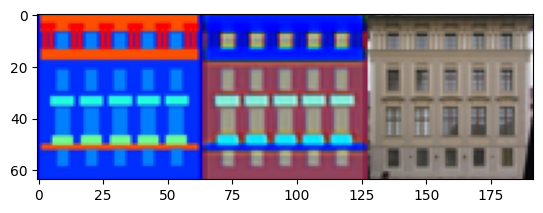

In epoch =   11/100. mean of V(D,G) = -9.17108952999115/120



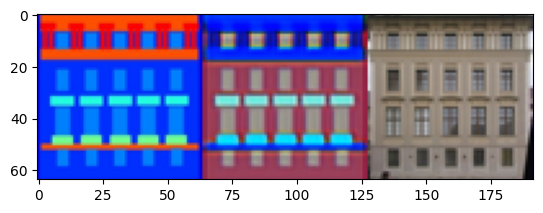

In epoch =   11/100. mean of V(D,G) = -18.973180055618286/160



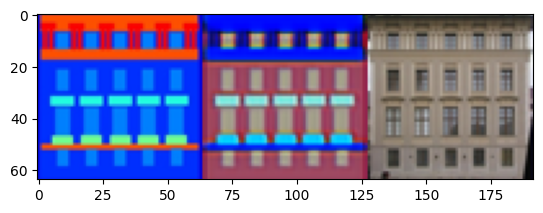

In epoch =   11/100. mean of V(D,G) = -9.821736812591553/200



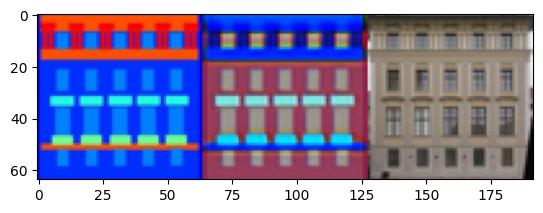

In epoch =   11/100. mean of V(D,G) = -9.26534652709961/240



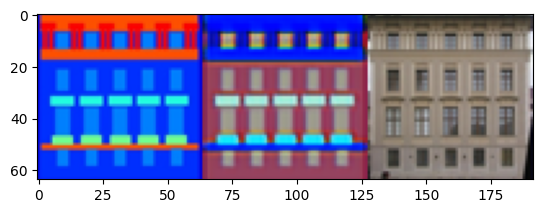

In epoch =   11/100. mean of V(D,G) = -6.272643208503723/280



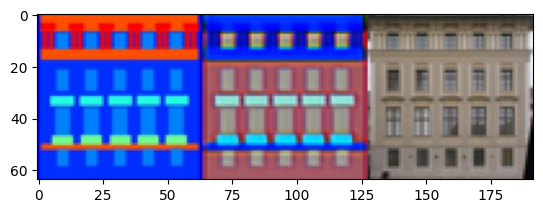

In epoch =   11/100. mean of V(D,G) = -7.005706429481506/320



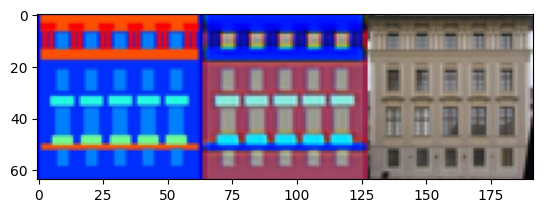

In epoch =   11/100. mean of V(D,G) = -11.219456195831299/360



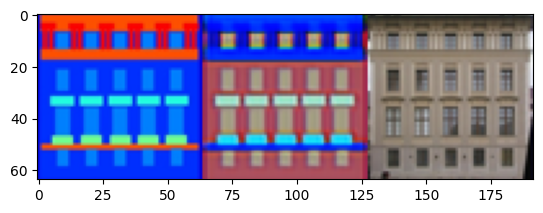

In epoch =   11/100. mean of V(D,G) = -5.418781042098999/400



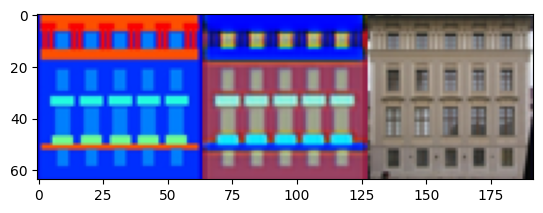

In epoch =   12/100. mean of V(D,G) = -5.58681845664978/40



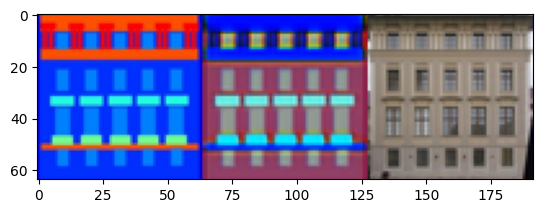

In epoch =   12/100. mean of V(D,G) = -10.63732385635376/80



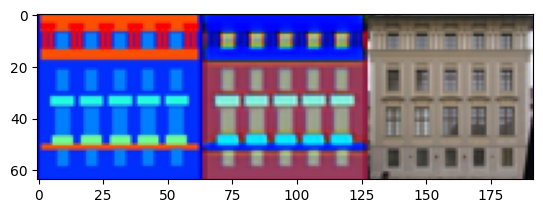

In epoch =   12/100. mean of V(D,G) = -5.679949522018433/120



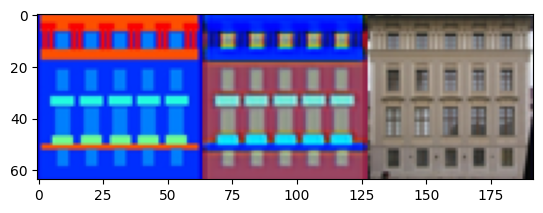

In epoch =   12/100. mean of V(D,G) = -9.913297891616821/160



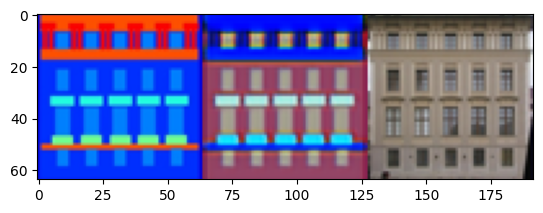

In epoch =   12/100. mean of V(D,G) = -6.596754789352417/200



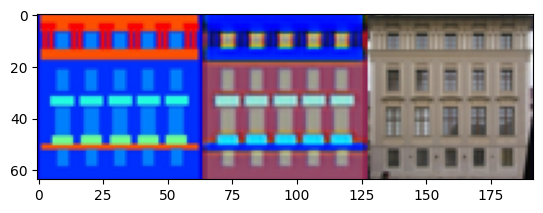

In epoch =   12/100. mean of V(D,G) = -8.444335460662842/240



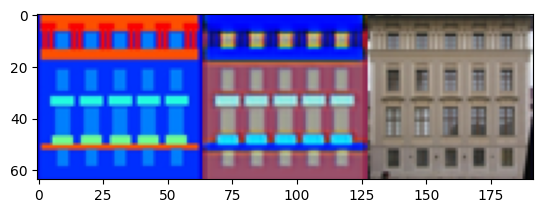

In epoch =   12/100. mean of V(D,G) = -4.901414215564728/280



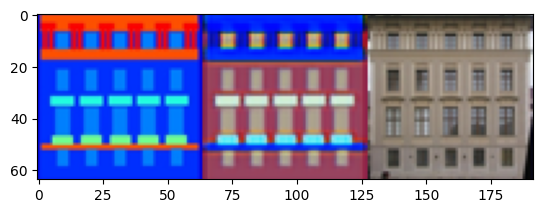

In epoch =   12/100. mean of V(D,G) = -6.258045434951782/320



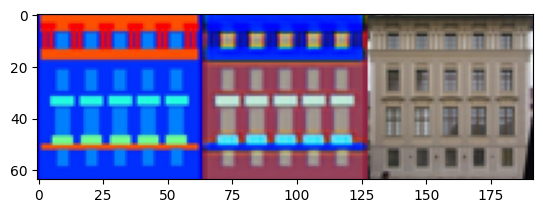

In epoch =   12/100. mean of V(D,G) = -11.088637113571167/360



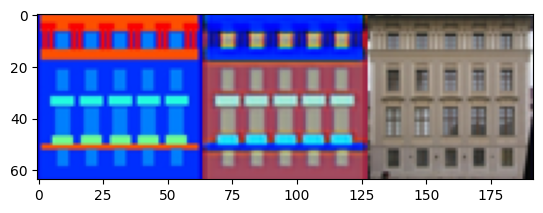

In epoch =   12/100. mean of V(D,G) = -4.740087389945984/400



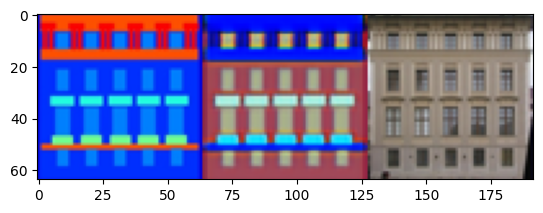

In epoch =   13/100. mean of V(D,G) = -6.302724480628967/40



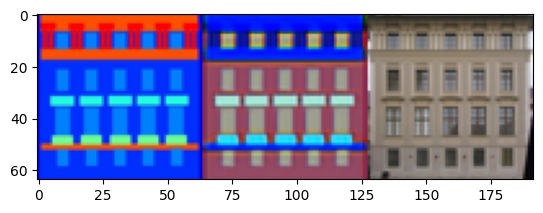

In epoch =   13/100. mean of V(D,G) = -11.435260772705078/80



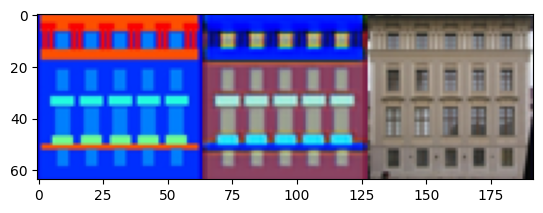

In epoch =   13/100. mean of V(D,G) = -5.385713577270508/120



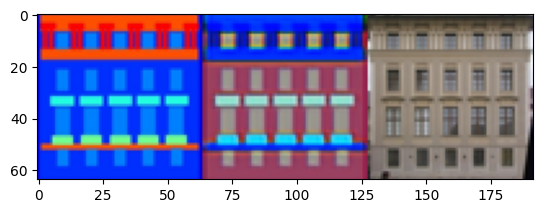

In epoch =   13/100. mean of V(D,G) = -11.983685493469238/160



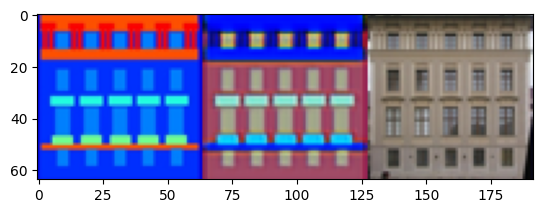

In epoch =   13/100. mean of V(D,G) = -10.967762470245361/200



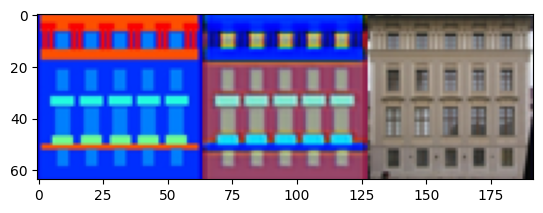

In epoch =   13/100. mean of V(D,G) = -16.34685754776001/240



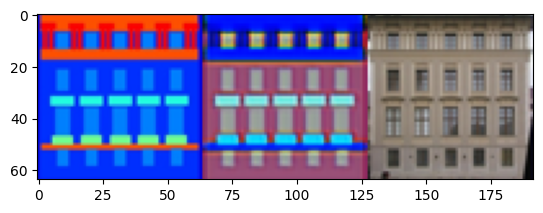

In epoch =   13/100. mean of V(D,G) = -5.39700984954834/280



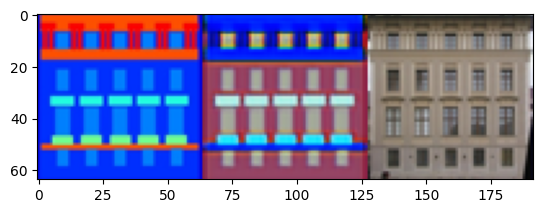

In epoch =   13/100. mean of V(D,G) = -6.195693612098694/320



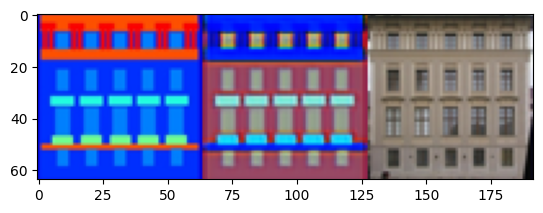

In epoch =   13/100. mean of V(D,G) = -10.098228454589844/360



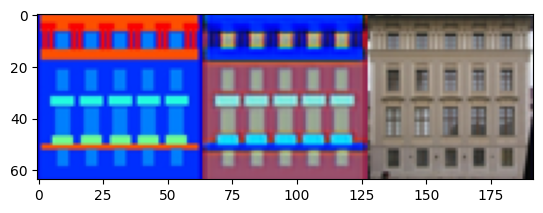

In epoch =   13/100. mean of V(D,G) = -3.740098476409912/400



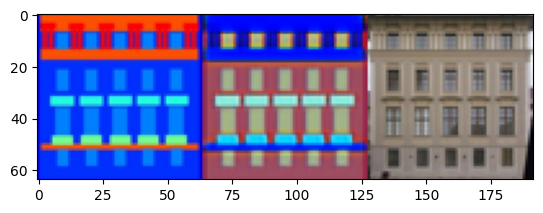

In epoch =   14/100. mean of V(D,G) = -4.502785801887512/40



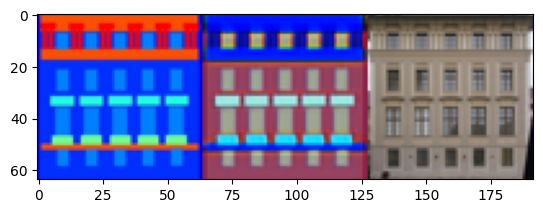

In epoch =   14/100. mean of V(D,G) = -9.820433259010315/80



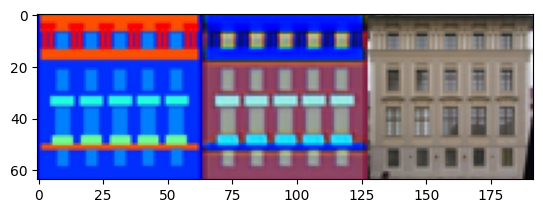

In epoch =   14/100. mean of V(D,G) = -5.4414743185043335/120



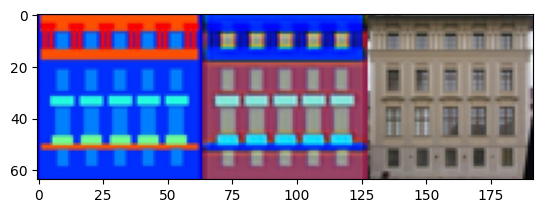

In epoch =   14/100. mean of V(D,G) = -10.571209192276001/160



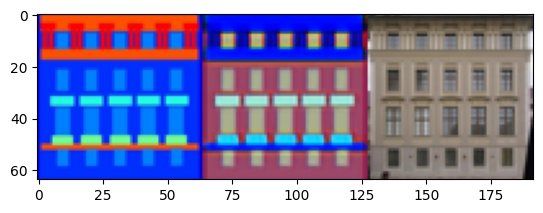

In epoch =   14/100. mean of V(D,G) = -5.5446553230285645/200



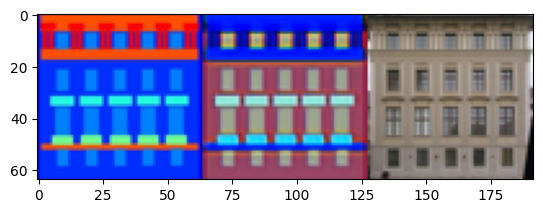

In epoch =   14/100. mean of V(D,G) = -9.726855754852295/240



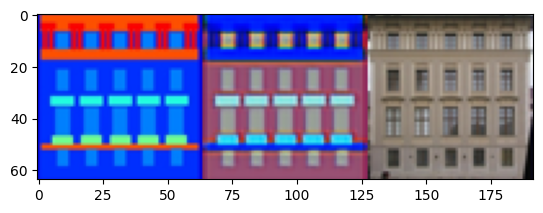

In epoch =   14/100. mean of V(D,G) = -4.669421315193176/280



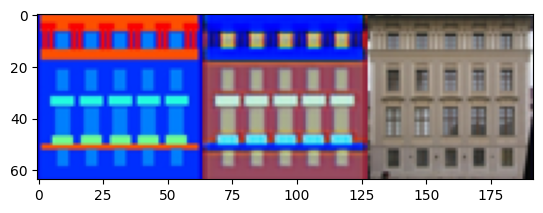

In epoch =   14/100. mean of V(D,G) = -5.5253177881240845/320



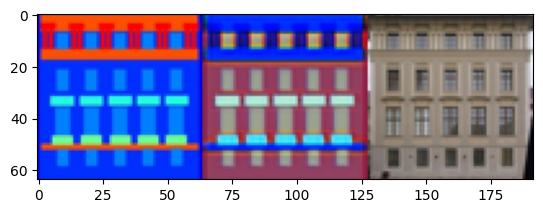

In epoch =   14/100. mean of V(D,G) = -10.856895446777344/360



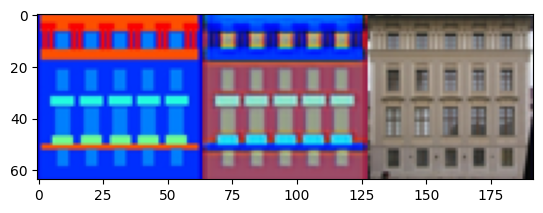

In epoch =   14/100. mean of V(D,G) = -3.588244318962097/400



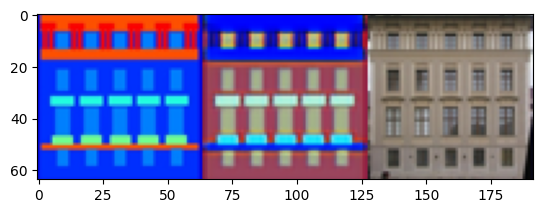

In epoch =   15/100. mean of V(D,G) = -4.385834336280823/40



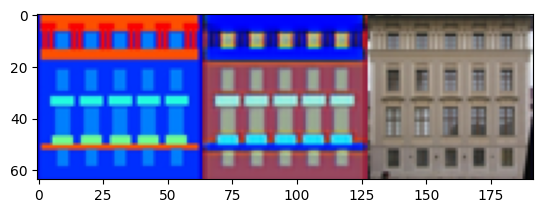

In epoch =   15/100. mean of V(D,G) = -9.303503632545471/80



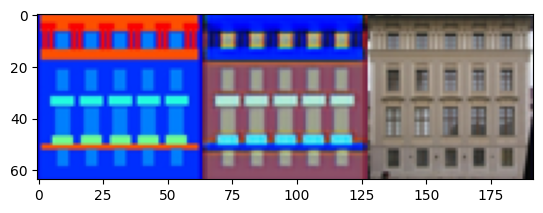

In epoch =   15/100. mean of V(D,G) = -4.976299405097961/120



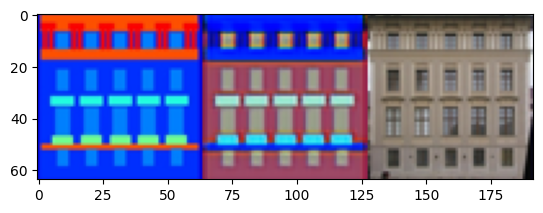

In epoch =   15/100. mean of V(D,G) = -9.491659998893738/160



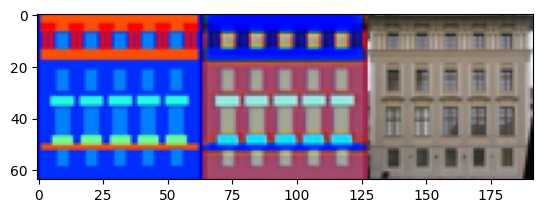

In epoch =   15/100. mean of V(D,G) = -6.158844828605652/200



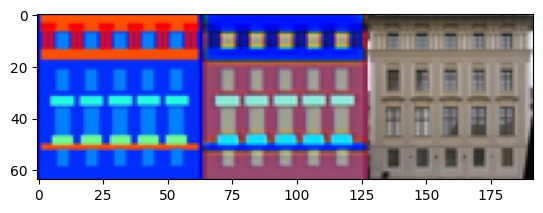

In epoch =   15/100. mean of V(D,G) = -7.312493920326233/240



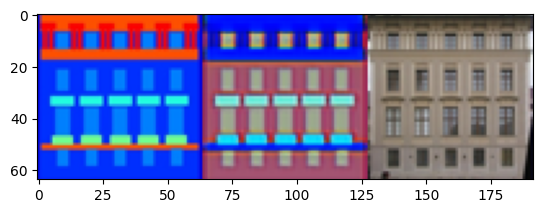

In epoch =   15/100. mean of V(D,G) = -4.307771027088165/280



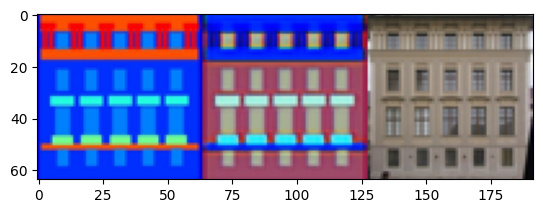

In epoch =   15/100. mean of V(D,G) = -7.178822755813599/320



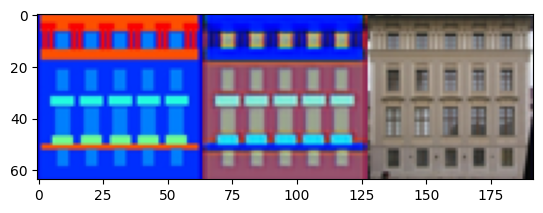

In epoch =   15/100. mean of V(D,G) = -12.094050645828247/360



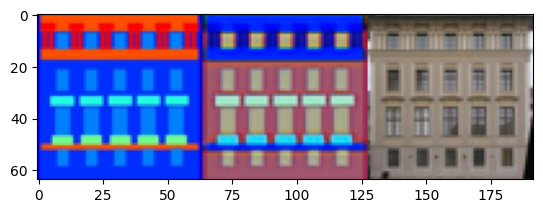

In epoch =   15/100. mean of V(D,G) = -3.6301496624946594/400



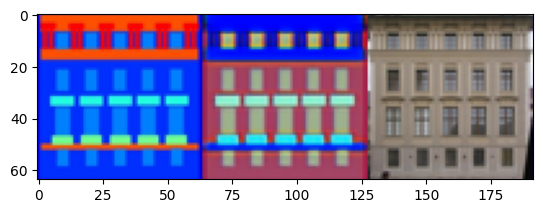

In epoch =   16/100. mean of V(D,G) = -3.884032666683197/40



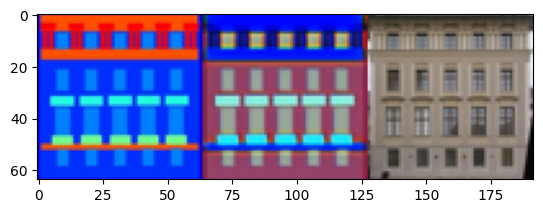

In epoch =   16/100. mean of V(D,G) = -8.364327549934387/80



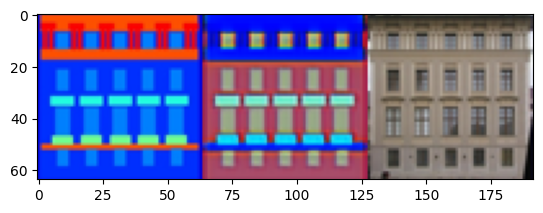

In epoch =   16/100. mean of V(D,G) = -6.11061692237854/120



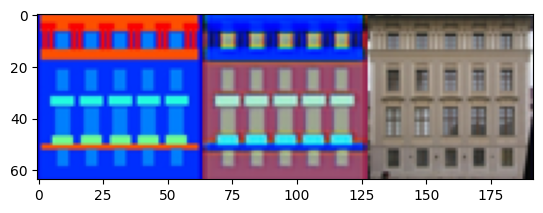

In epoch =   16/100. mean of V(D,G) = -11.839113235473633/160



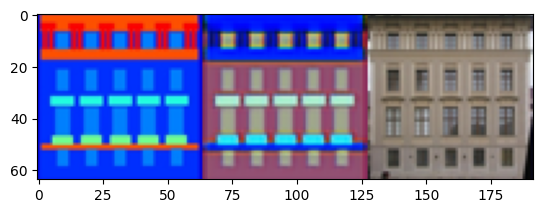

In epoch =   16/100. mean of V(D,G) = -5.446577072143555/200



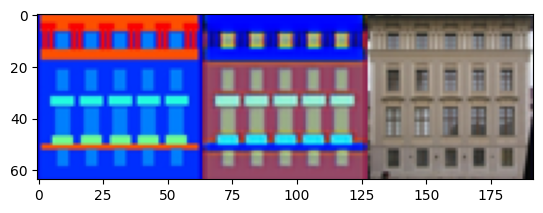

In epoch =   16/100. mean of V(D,G) = -5.559695363044739/240



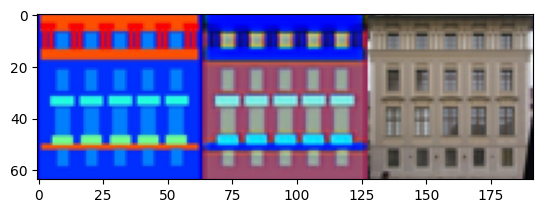

In epoch =   16/100. mean of V(D,G) = -4.110698997974396/280



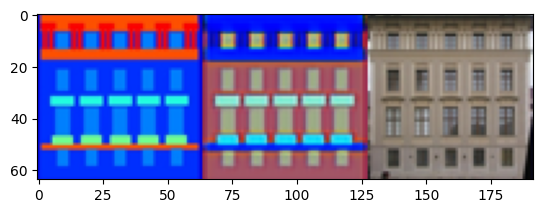

In epoch =   16/100. mean of V(D,G) = -5.069352388381958/320



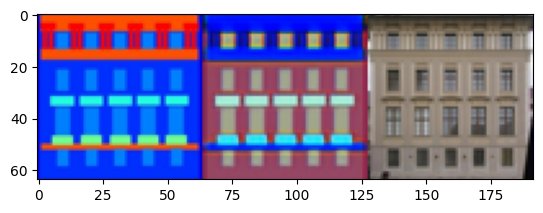

In epoch =   16/100. mean of V(D,G) = -10.226055383682251/360



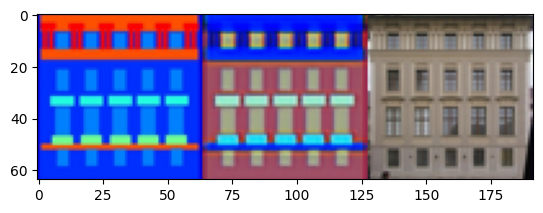

In epoch =   16/100. mean of V(D,G) = -5.366120338439941/400



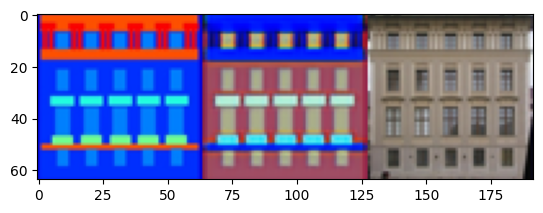

In epoch =   17/100. mean of V(D,G) = -6.27366840839386/40



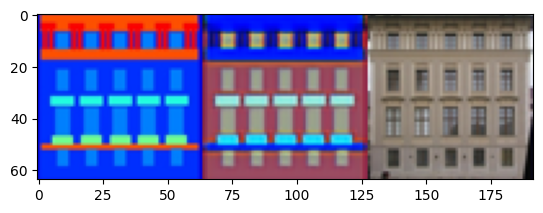

In epoch =   17/100. mean of V(D,G) = -14.422639608383179/80



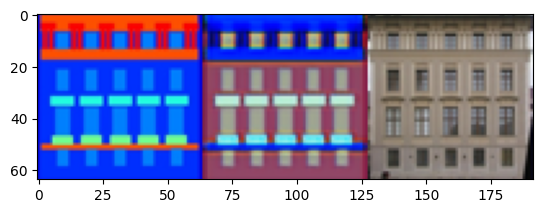

In epoch =   17/100. mean of V(D,G) = -5.560214519500732/120



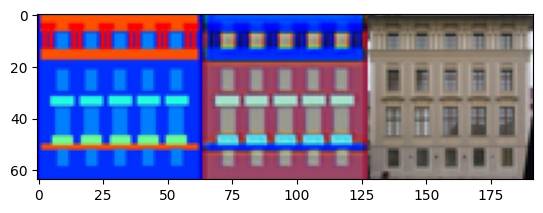

In epoch =   17/100. mean of V(D,G) = -8.738829493522644/160



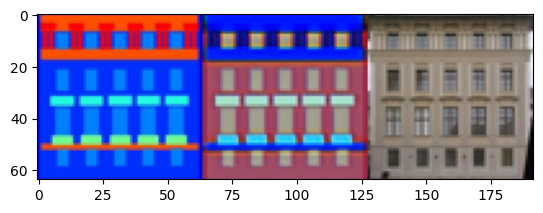

In epoch =   17/100. mean of V(D,G) = -18.95458698272705/200



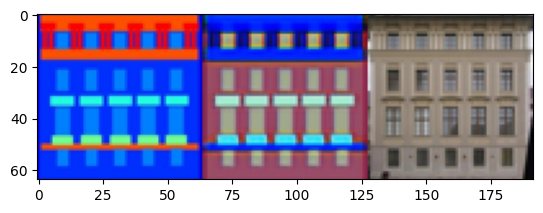

In epoch =   17/100. mean of V(D,G) = -38.294517993927/240



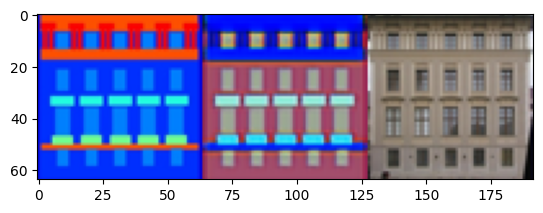

In epoch =   17/100. mean of V(D,G) = -23.46479892730713/280



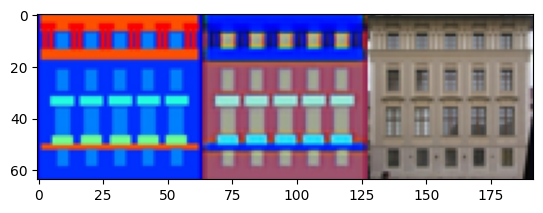

In epoch =   17/100. mean of V(D,G) = -18.14059853553772/320



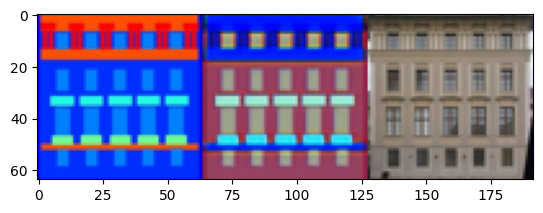

In epoch =   17/100. mean of V(D,G) = -14.664454460144043/360



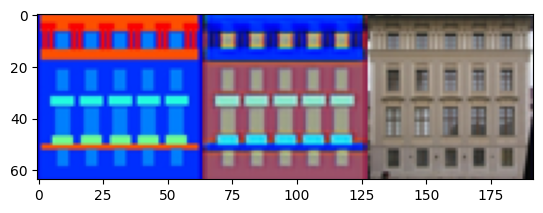

In epoch =   17/100. mean of V(D,G) = -8.261522054672241/400



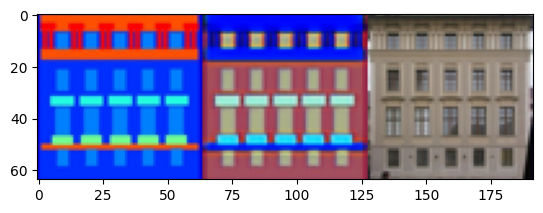

In epoch =   18/100. mean of V(D,G) = -6.771036982536316/40



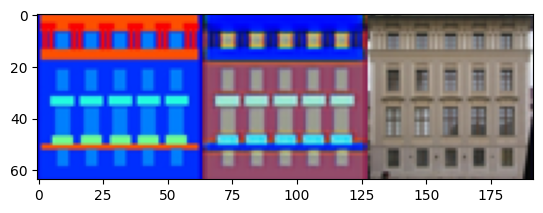

In epoch =   18/100. mean of V(D,G) = -9.233428239822388/80



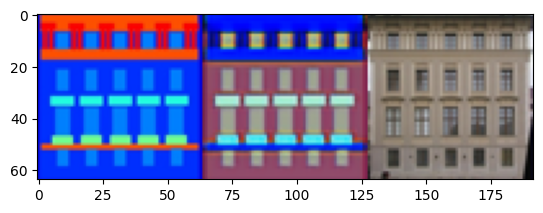

In epoch =   18/100. mean of V(D,G) = -6.195138692855835/120



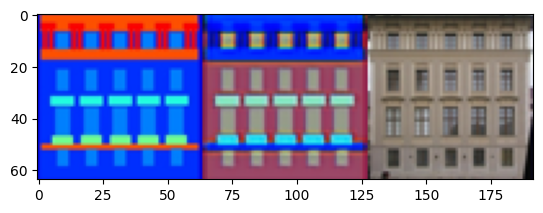

In epoch =   18/100. mean of V(D,G) = -11.381440162658691/160



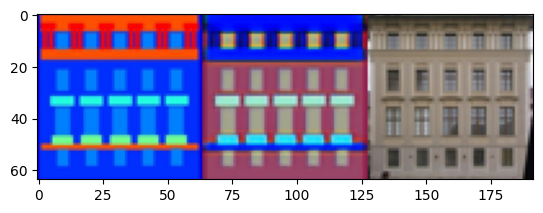

In epoch =   18/100. mean of V(D,G) = -6.549137830734253/200



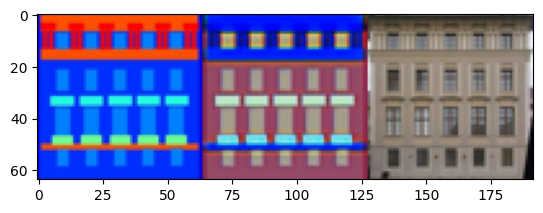

In epoch =   18/100. mean of V(D,G) = -7.266446352005005/240



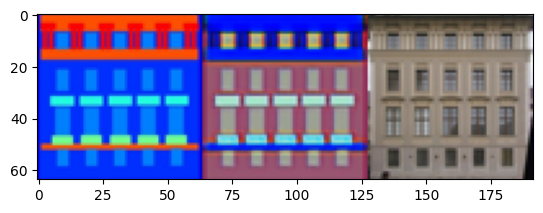

In epoch =   18/100. mean of V(D,G) = -4.835214018821716/280



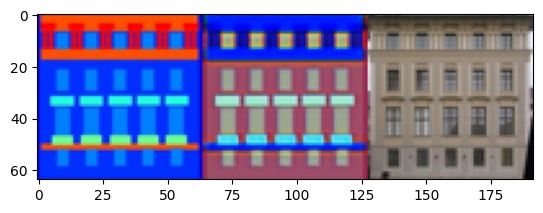

In epoch =   18/100. mean of V(D,G) = -8.845096826553345/320



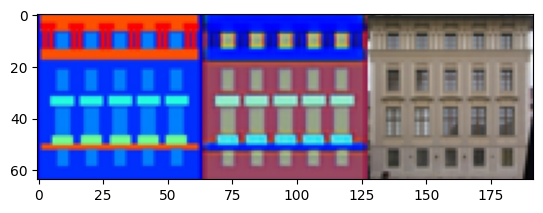

In epoch =   18/100. mean of V(D,G) = -11.319584846496582/360



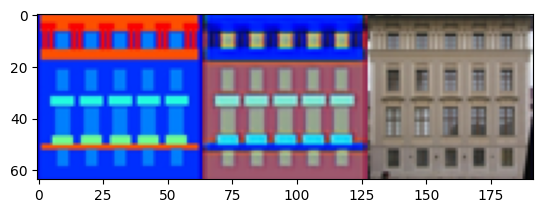

In epoch =   18/100. mean of V(D,G) = -4.118666350841522/400



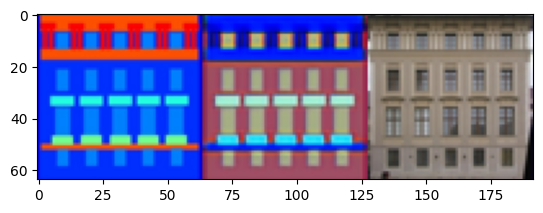

In epoch =   19/100. mean of V(D,G) = -4.477962255477905/40



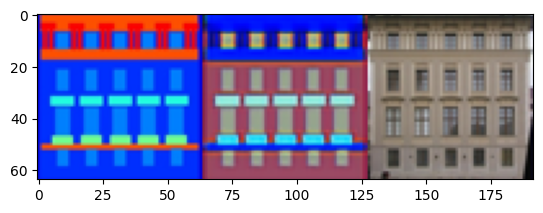

In epoch =   19/100. mean of V(D,G) = -8.006184697151184/80



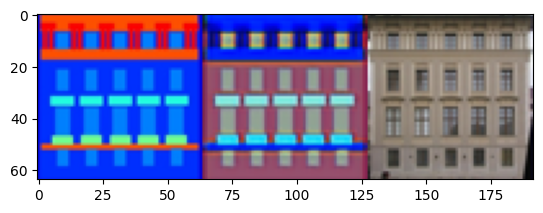

In epoch =   19/100. mean of V(D,G) = -4.926897585391998/120



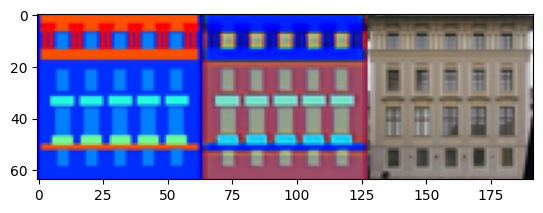

In epoch =   19/100. mean of V(D,G) = -9.854295253753662/160



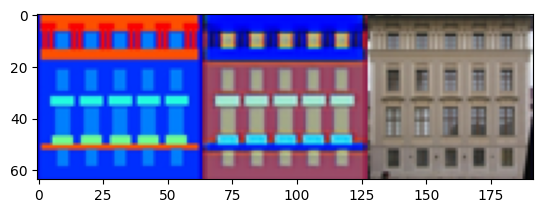

In epoch =   19/100. mean of V(D,G) = -6.859747767448425/200



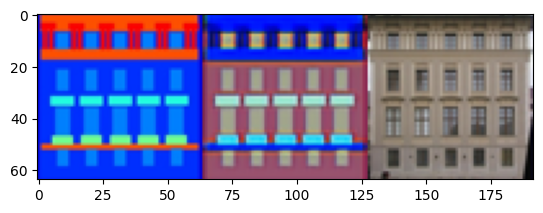

In epoch =   19/100. mean of V(D,G) = -5.400063395500183/240



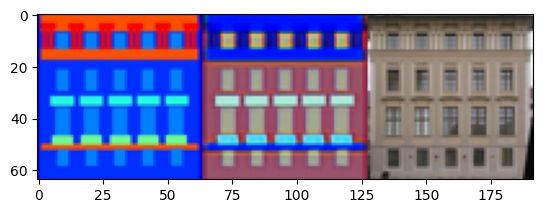

In epoch =   19/100. mean of V(D,G) = -4.334788918495178/280



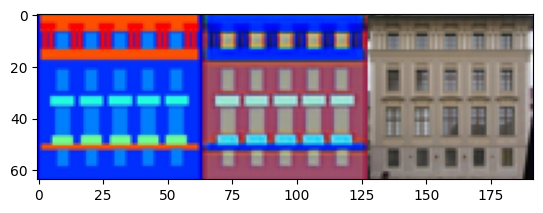

In epoch =   19/100. mean of V(D,G) = -5.153467059135437/320



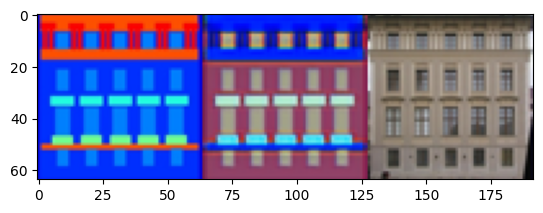

In epoch =   19/100. mean of V(D,G) = -9.808521270751953/360



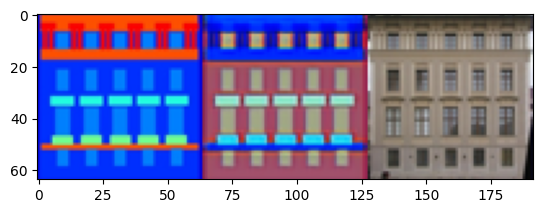

In epoch =   19/100. mean of V(D,G) = -5.385106205940247/400



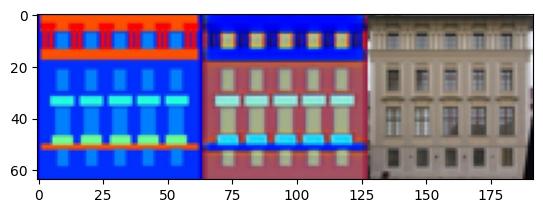

In epoch =   20/100. mean of V(D,G) = -3.4681349992752075/40



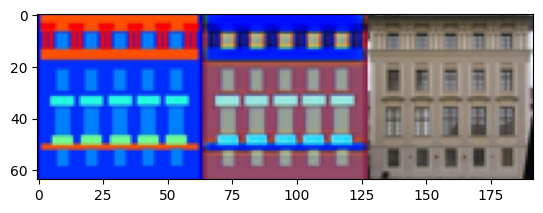

In epoch =   20/100. mean of V(D,G) = -7.7565062046051025/80



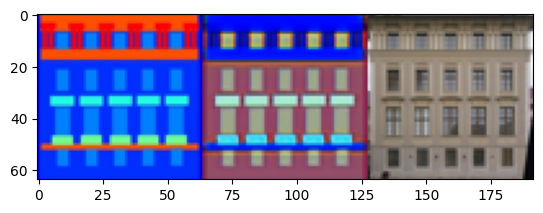

In epoch =   20/100. mean of V(D,G) = -4.517816603183746/120



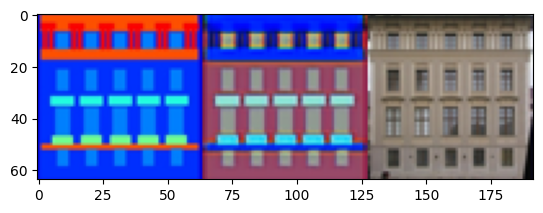

In epoch =   20/100. mean of V(D,G) = -9.527928829193115/160



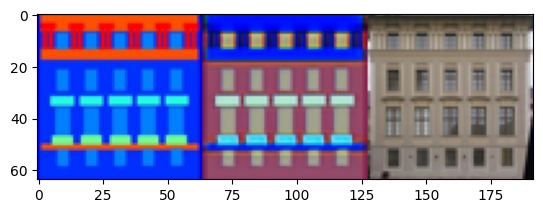

In epoch =   20/100. mean of V(D,G) = -5.599203705787659/200



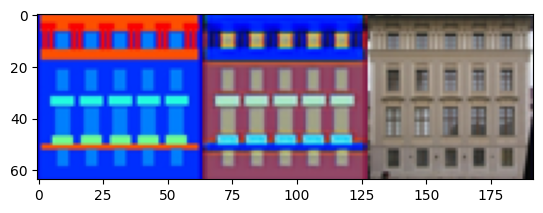

In epoch =   20/100. mean of V(D,G) = -4.866275489330292/240



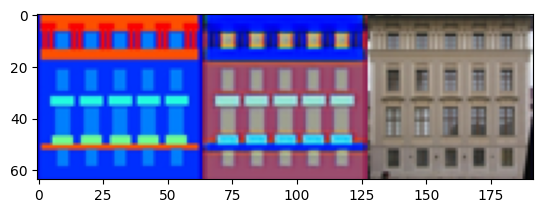

In epoch =   20/100. mean of V(D,G) = -3.991399109363556/280



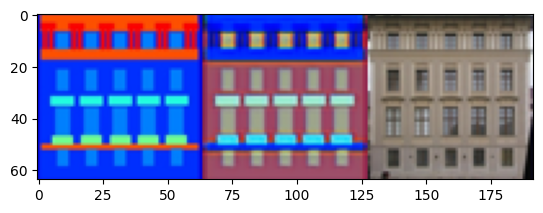

In epoch =   20/100. mean of V(D,G) = -4.700310826301575/320



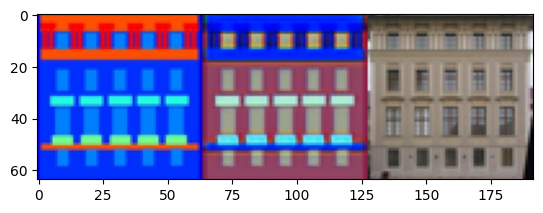

In epoch =   20/100. mean of V(D,G) = -9.530333280563354/360



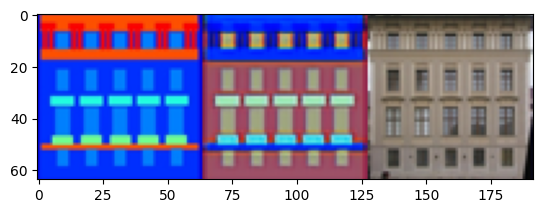

In epoch =   20/100. mean of V(D,G) = -4.365764856338501/400



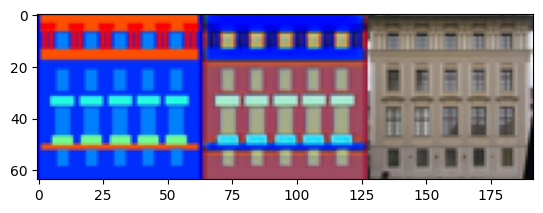

In epoch =   21/100. mean of V(D,G) = -3.200376331806183/40



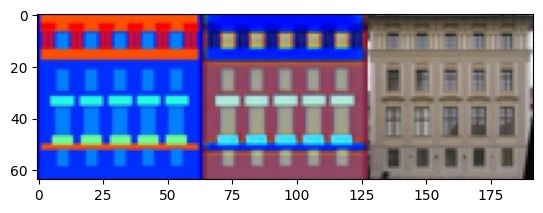

In epoch =   21/100. mean of V(D,G) = -8.17808210849762/80



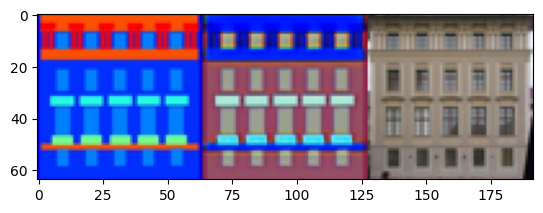

In epoch =   21/100. mean of V(D,G) = -4.550017416477203/120



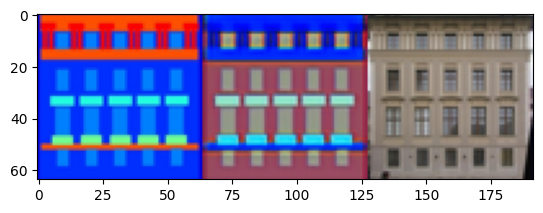

In epoch =   21/100. mean of V(D,G) = -9.183403849601746/160



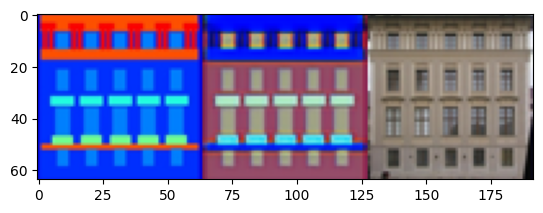

In epoch =   21/100. mean of V(D,G) = -5.9166038036346436/200



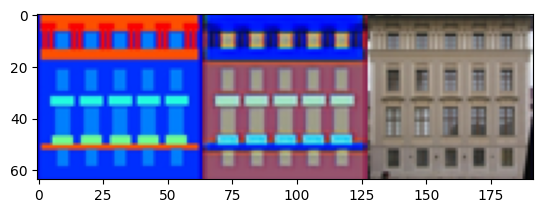

In epoch =   21/100. mean of V(D,G) = -4.976984858512878/240



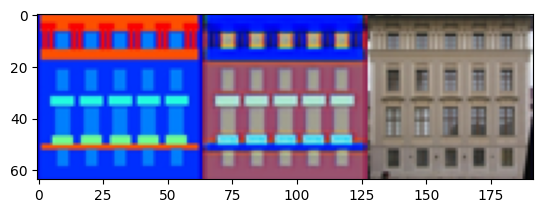

In epoch =   21/100. mean of V(D,G) = -3.386334180831909/280



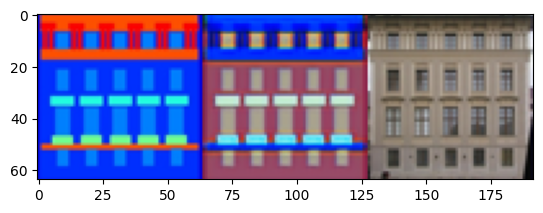

In epoch =   21/100. mean of V(D,G) = -4.67808872461319/320



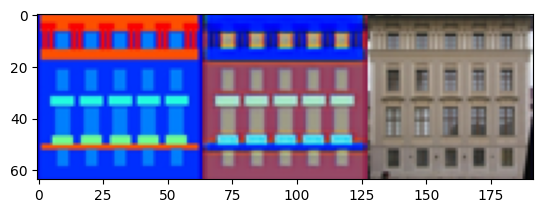

In epoch =   21/100. mean of V(D,G) = -9.55822229385376/360



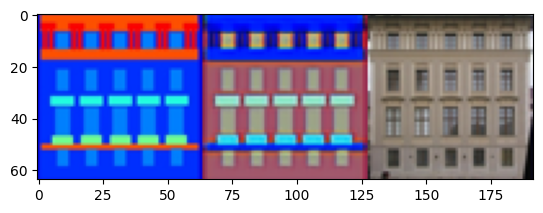

In epoch =   21/100. mean of V(D,G) = -3.8212066888809204/400



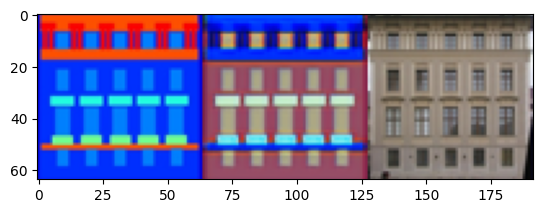

In epoch =   22/100. mean of V(D,G) = -2.8099271655082703/40



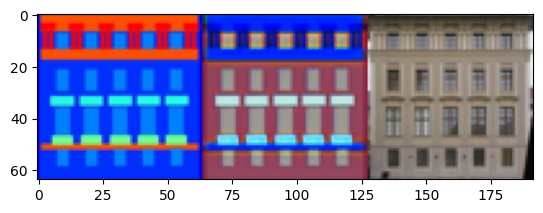

In epoch =   22/100. mean of V(D,G) = -7.447654604911804/80



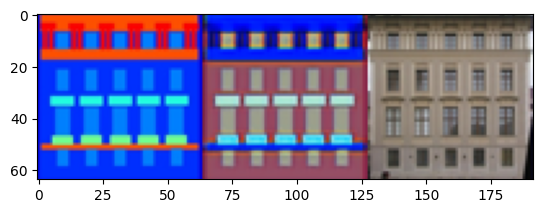

In epoch =   22/100. mean of V(D,G) = -4.1181254386901855/120



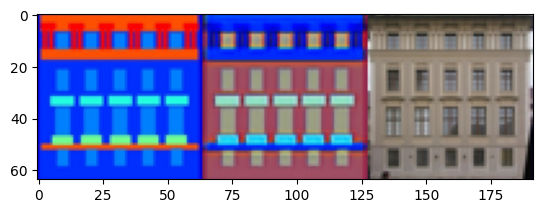

In epoch =   22/100. mean of V(D,G) = -8.491380214691162/160



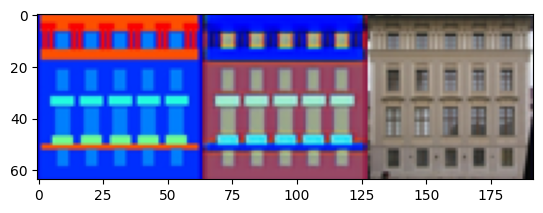

In epoch =   22/100. mean of V(D,G) = -9.230031967163086/200



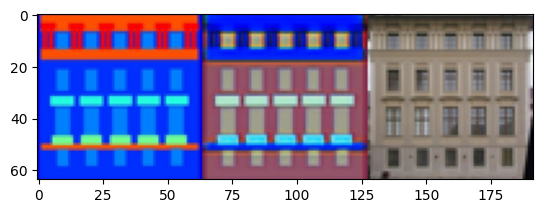

In epoch =   22/100. mean of V(D,G) = -9.136460423469543/240



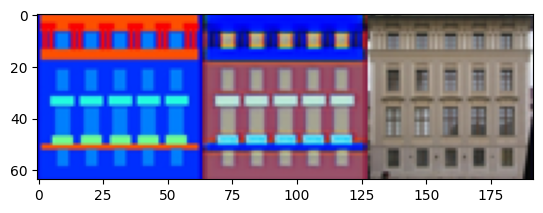

In epoch =   22/100. mean of V(D,G) = -7.388059496879578/280



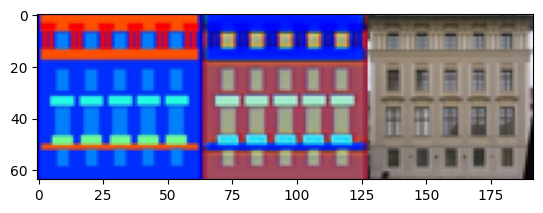

In epoch =   22/100. mean of V(D,G) = -8.205647468566895/320



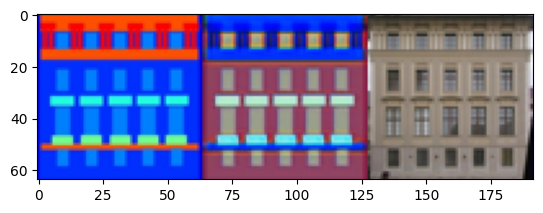

In epoch =   22/100. mean of V(D,G) = -12.510988712310791/360



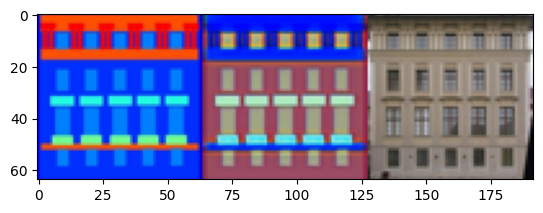

In epoch =   22/100. mean of V(D,G) = -4.324129223823547/400



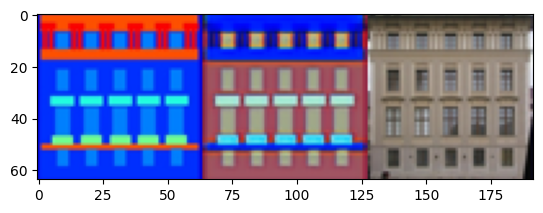

In epoch =   23/100. mean of V(D,G) = -3.911147713661194/40



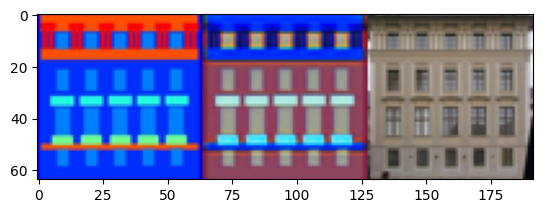

In epoch =   23/100. mean of V(D,G) = -7.147234082221985/80



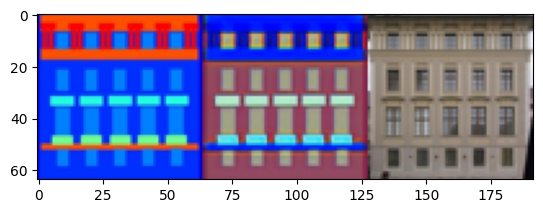

In epoch =   23/100. mean of V(D,G) = -4.817596971988678/120



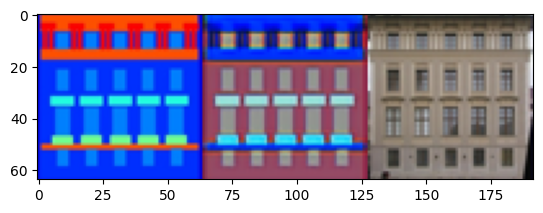

In epoch =   23/100. mean of V(D,G) = -9.33845579624176/160



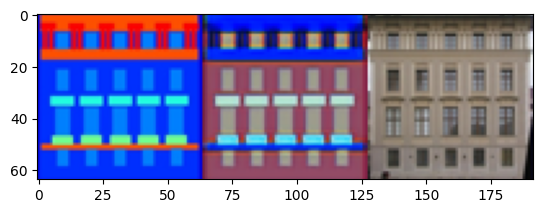

In epoch =   23/100. mean of V(D,G) = -5.758597254753113/200



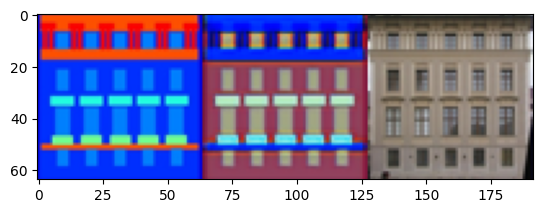

In epoch =   23/100. mean of V(D,G) = -4.692612290382385/240



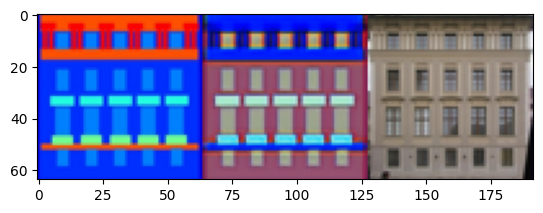

In epoch =   23/100. mean of V(D,G) = -3.2554540038108826/280



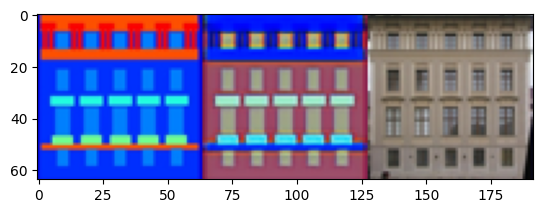

In epoch =   23/100. mean of V(D,G) = -4.561824202537537/320



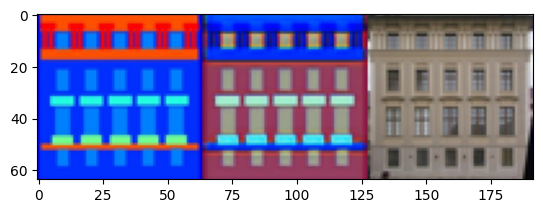

In epoch =   23/100. mean of V(D,G) = -9.600322246551514/360



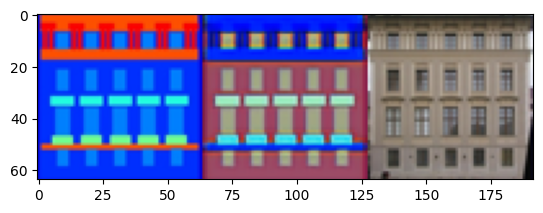

In epoch =   23/100. mean of V(D,G) = -2.8818458318710327/400



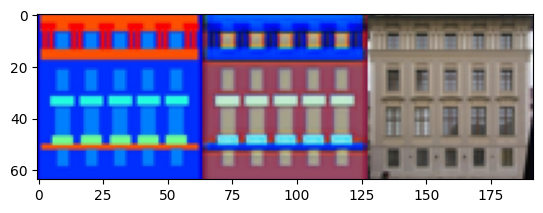

In epoch =   24/100. mean of V(D,G) = -2.844870090484619/40



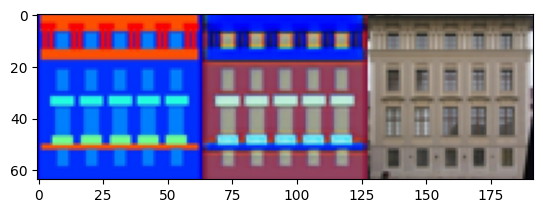

In epoch =   24/100. mean of V(D,G) = -6.726447939872742/80



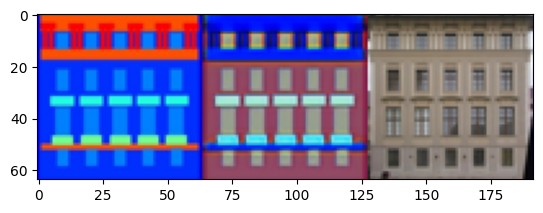

In epoch =   24/100. mean of V(D,G) = -4.228070378303528/120



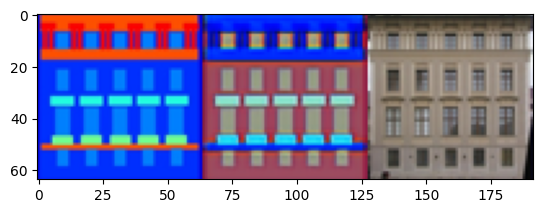

In epoch =   24/100. mean of V(D,G) = -8.614252805709839/160



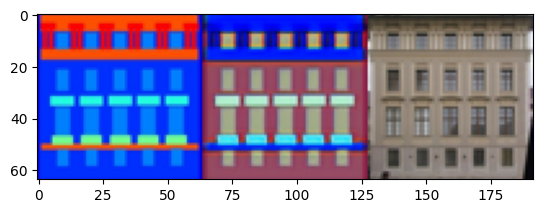

In epoch =   24/100. mean of V(D,G) = -8.986845016479492/200



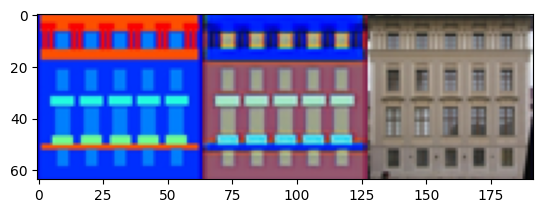

In epoch =   24/100. mean of V(D,G) = -7.032987475395203/240



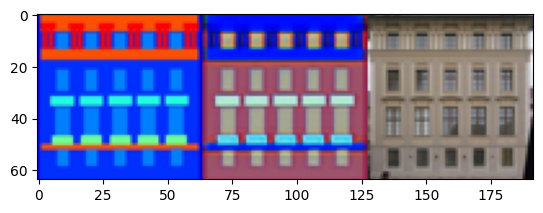

In epoch =   24/100. mean of V(D,G) = -5.156451463699341/280



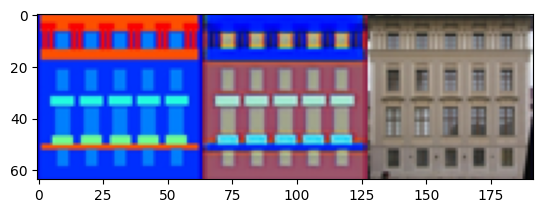

In epoch =   24/100. mean of V(D,G) = -6.468508243560791/320



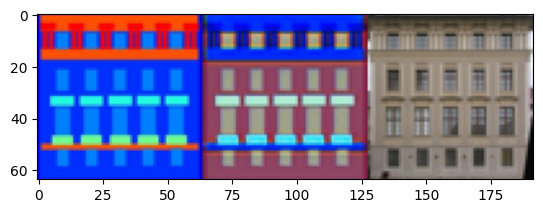

In epoch =   24/100. mean of V(D,G) = -11.273952722549438/360



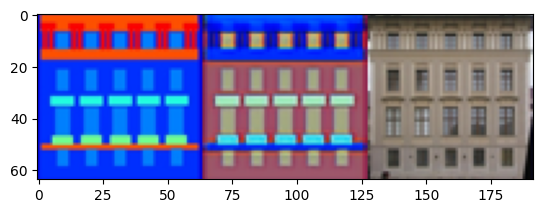

In epoch =   24/100. mean of V(D,G) = -3.487650752067566/400



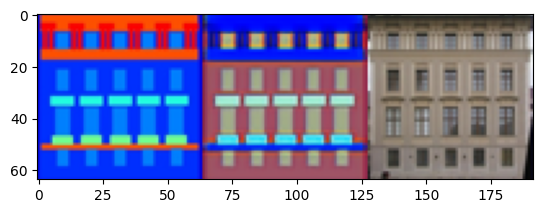

In epoch =   25/100. mean of V(D,G) = -3.642774522304535/40



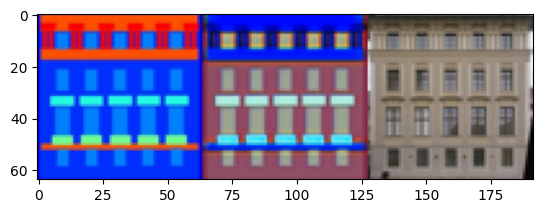

In epoch =   25/100. mean of V(D,G) = -6.939477324485779/80



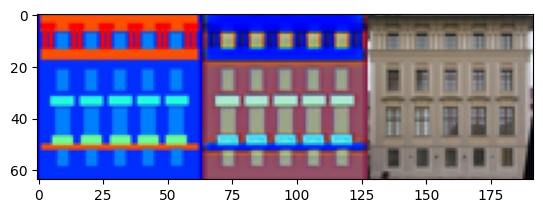

In epoch =   25/100. mean of V(D,G) = -4.509555101394653/120



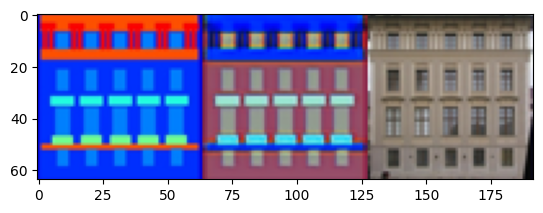

In epoch =   25/100. mean of V(D,G) = -8.77241849899292/160



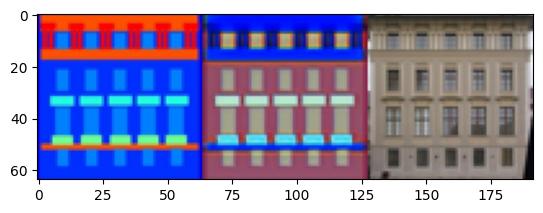

In epoch =   25/100. mean of V(D,G) = -4.543585777282715/200



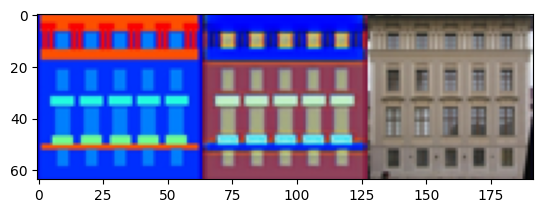

In epoch =   25/100. mean of V(D,G) = -4.4125035405159/240



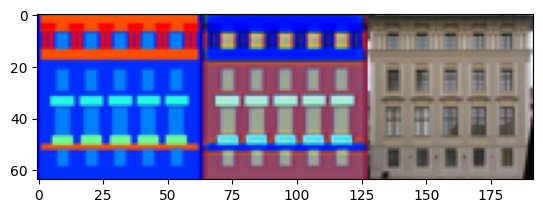

In epoch =   25/100. mean of V(D,G) = -3.018482029438019/280



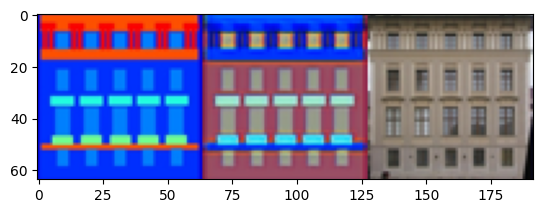

In epoch =   25/100. mean of V(D,G) = -4.153418242931366/320



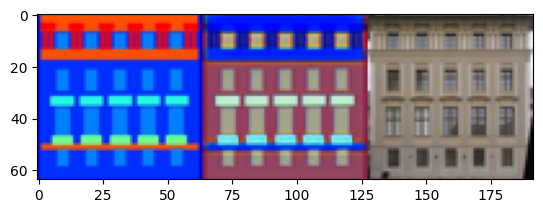

In epoch =   25/100. mean of V(D,G) = -9.484726786613464/360



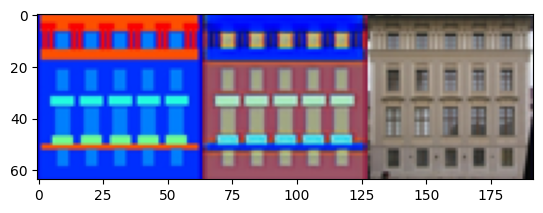

In epoch =   25/100. mean of V(D,G) = -2.5022274255752563/400



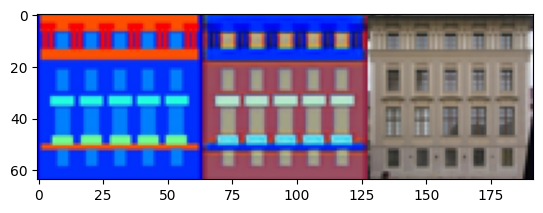

In epoch =   26/100. mean of V(D,G) = -2.3922283947467804/40



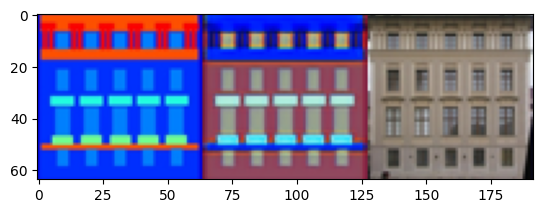

In epoch =   26/100. mean of V(D,G) = -6.453280448913574/80



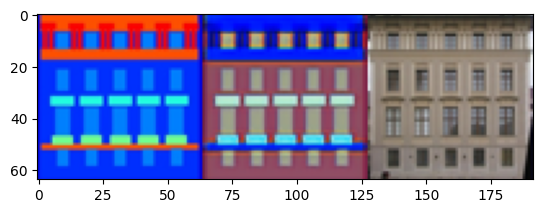

In epoch =   26/100. mean of V(D,G) = -3.98135244846344/120



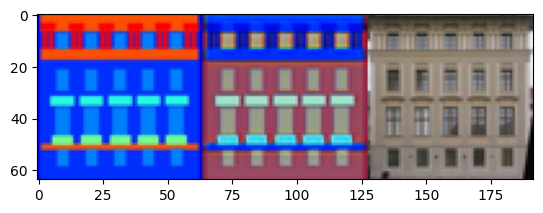

In epoch =   26/100. mean of V(D,G) = -7.875235080718994/160



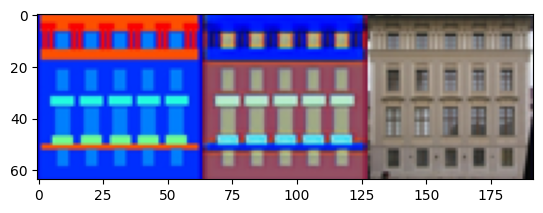

In epoch =   26/100. mean of V(D,G) = -6.789954900741577/200



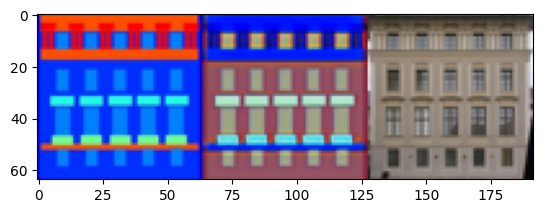

In epoch =   26/100. mean of V(D,G) = -6.119801998138428/240



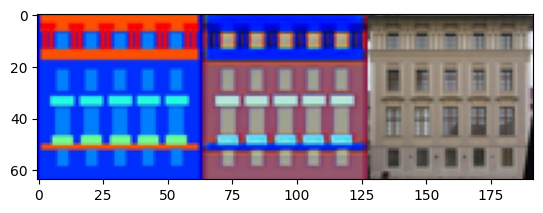

In epoch =   26/100. mean of V(D,G) = -4.0863195061683655/280



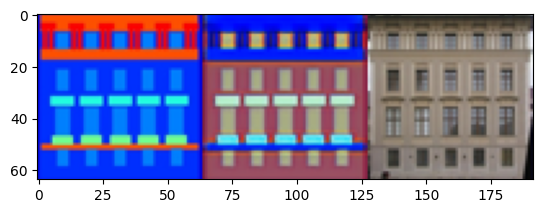

In epoch =   26/100. mean of V(D,G) = -112.0380973815918/320



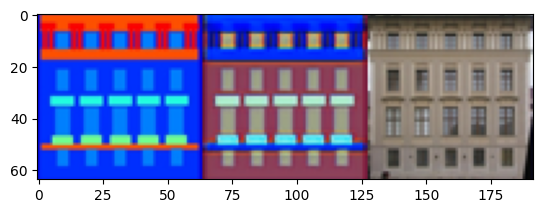

In epoch =   26/100. mean of V(D,G) = -14.242156744003296/360



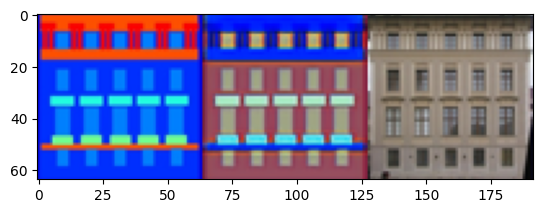

In epoch =   26/100. mean of V(D,G) = -2.274560332298279/400



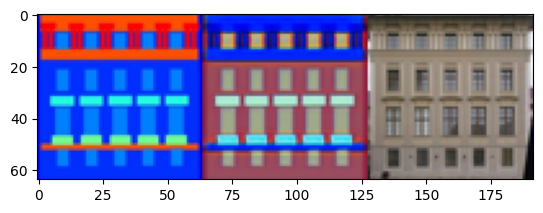

In epoch =   27/100. mean of V(D,G) = -2.6725131273269653/40



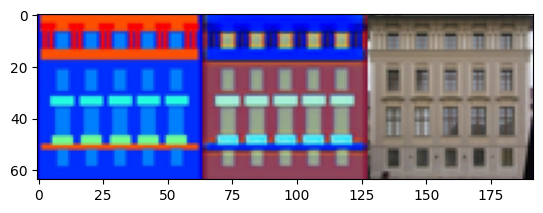

In epoch =   27/100. mean of V(D,G) = -8.690046072006226/80



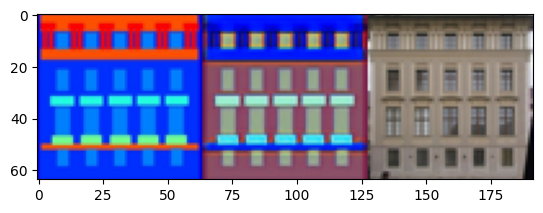

In epoch =   27/100. mean of V(D,G) = -4.158934056758881/120



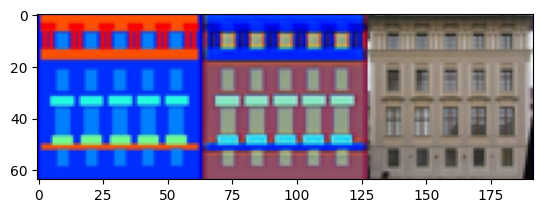

In epoch =   27/100. mean of V(D,G) = -11.23136281967163/160



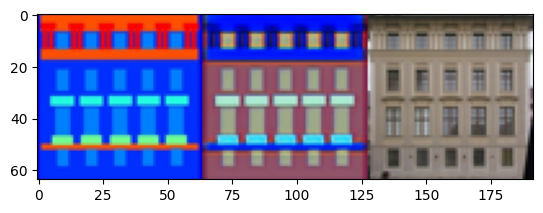

In epoch =   27/100. mean of V(D,G) = -6.950132846832275/200



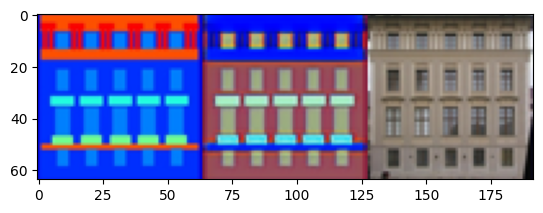

In epoch =   27/100. mean of V(D,G) = -8.340134024620056/240



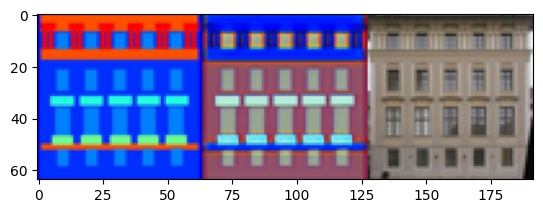

In epoch =   27/100. mean of V(D,G) = -3.4588193893432617/280



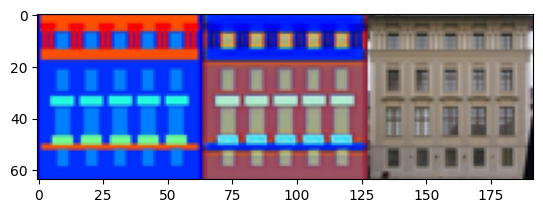

In epoch =   27/100. mean of V(D,G) = -5.900992751121521/320



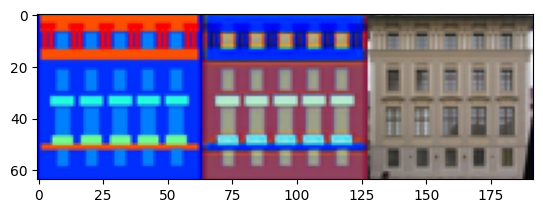

In epoch =   27/100. mean of V(D,G) = -11.381068229675293/360



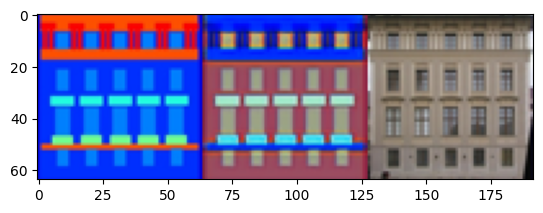

In epoch =   27/100. mean of V(D,G) = -2.925225794315338/400



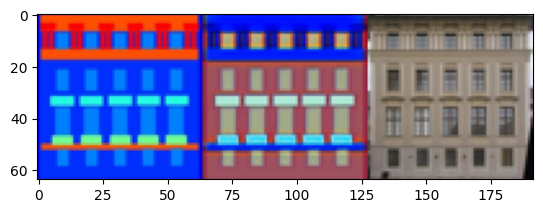

In epoch =   28/100. mean of V(D,G) = -2.9803434014320374/40



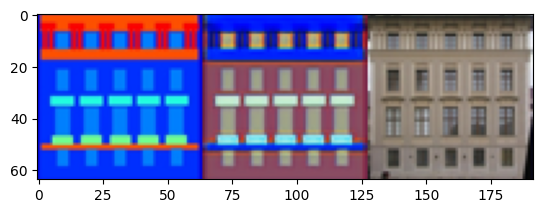

In epoch =   28/100. mean of V(D,G) = -6.562066078186035/80



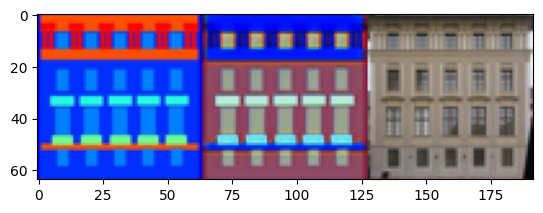

In epoch =   28/100. mean of V(D,G) = -3.887031078338623/120



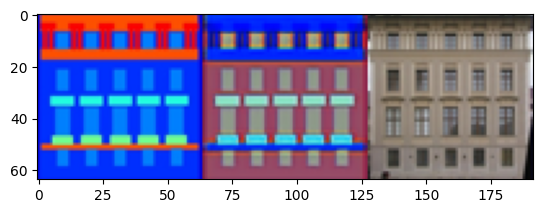

In epoch =   28/100. mean of V(D,G) = -8.817331790924072/160



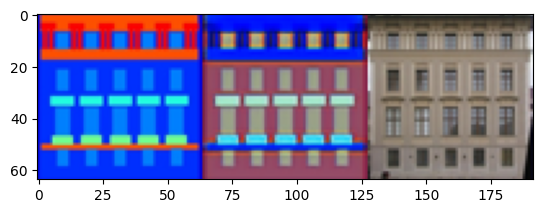

In epoch =   28/100. mean of V(D,G) = -8.073363900184631/200



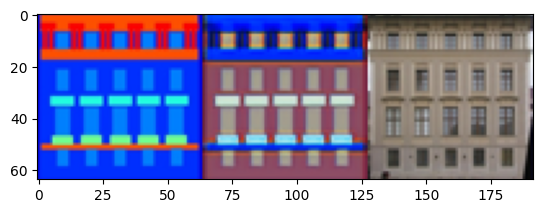

In epoch =   28/100. mean of V(D,G) = -7.678853273391724/240



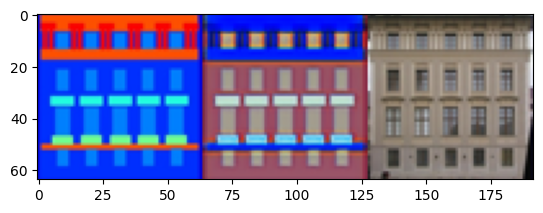

In epoch =   28/100. mean of V(D,G) = -3.589477241039276/280



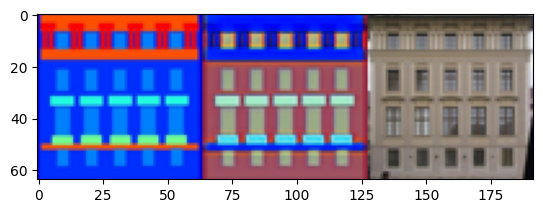

In epoch =   28/100. mean of V(D,G) = -4.781762659549713/320



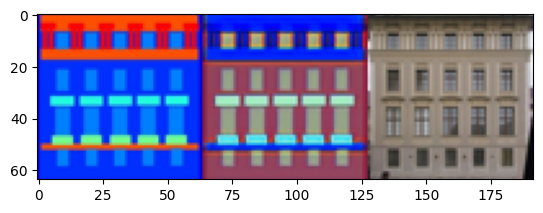

In epoch =   28/100. mean of V(D,G) = -10.152249336242676/360



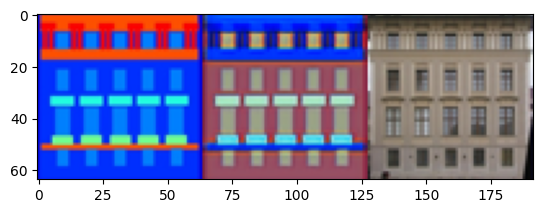

In epoch =   28/100. mean of V(D,G) = -3.943352699279785/400



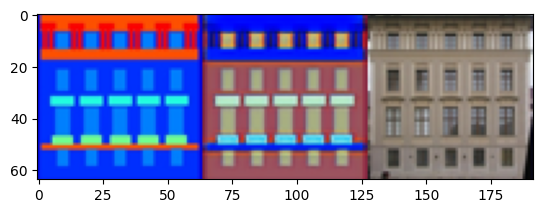

In epoch =   29/100. mean of V(D,G) = -2.3499512672424316/40



KeyboardInterrupt: 

In [9]:
# Learning
for e in range(epoch):
  loss_V = .0
  num_batch = 0
  for i ,( x, y)in enumerate(zip(x_trains,y_trains)):
    N = x.shape[0]
    opt_D.zero_grad() # opt_Dに存在する勾配を初期化
    Gy = G(y)
    Fx = F(x)
    
    DYy = DY(y)
    DXx = DX(x)

    DYFx = DY(Fx)
    DXGy = DX(Gy)

    loss_DY_real = -bceloss(DYy,torch.ones(DYy.shape,device=dev)) \
    /(N*DYy.shape[2]*DYy.shape[3])
    loss_DY_fake = -bceloss(DYFx,torch.zeros(DXx.shape,device=dev)) \
    /(N*DYFx.shape[2]*DYFx.shape[3])
    

    loss_DX_real = -bceloss(DXx,torch.ones(DYy.shape,device=dev)) \
    /(N*DXx.shape[2]*DXx.shape[3])
    loss_DX_fake = -bceloss(DYFx,torch.zeros(DXx.shape,device=dev)) \
    /(N*DXGy.shape[2]*DXGy.shape[3])
    
    loss_D = loss_DY_real+loss_DY_fake +loss_DX_real+loss_DX_fake
    loss_V = N*loss_D.item()
    num_batch += N
    loss_D_reverse = -loss_D # 損失関数を増加させるために±の反転

    loss_D_reverse.backward()#逆伝搬
    opt_D.step() # Dの更新

    # GについてMiniMize
    opt_GF.zero_grad()
    Gy = G(y)
    Fx =F(x)
    DYFx = DY(Fx)
    DXGy = DX(Gy)

    loss_DY_fake = bceloss(DYFx,torch.ones(DYFx.shape,device=dev)) \
    /(N*DYFx.shape[2]*DYFx.shape[3])
    loss_DX_fake = bceloss(DXGy,torch.ones(DXGy.shape,device=dev)) \
    /(N*DXGy.shape[2]*DXGy.shape[3])
    loss_xGFx_L1 = l1loss(x,G(Fx))/(N*x.shape[1]*x.shape[2]*x.shape[3])
    loss_yFGy_L1 = l1loss(y,G(Gy))/(N*y.shape[1]*y.shape[2]*y.shape[3])
    loss_GF = loss_DY_fake + loss_DX_fake + (loss_xGFx_L1 + loss_yFGy_L1)*lambda_L1

    loss_GF.backward()
    opt_GF.step()
    
    
    print(f"In epoch = {e+1:4d}/{epoch}. mean of V(D,G) = {loss_V}/{num_batch}")
    print()

    with torch.no_grad():
      idx = 101
      img_Gy = (torch.permute(
          G(y_train[idx].unsqueeze(dim=0))[0],(1,2,0))+1)/2#z,yを結合してGを写像
      img_x  = (torch.permute(x_train[idx],(1,2,0))+1)/2
      img_y = (torch.permute(y_train[idx],(1,2,0))+1)/2
      img = torch.clamp(torch.cat([img_y,img_Gy,img_x],dim=1),0,1)
      plt.imshow(img.to('cpu').detach().numpy().copy())
      plt.show()
